# World Data League 2022

## 🎯 Challenge
Identification of Dark Ecological Corridors🦇



## 👥 Authors
* Akshay Punjabi
* Pablo Izquierdo Ayala
* Chiara Rucco
* Enrico Coluccia

## 💻 Development

##### Imports, installs and downloading data

Installs

In [ ]:
!pip install haversine
!pip install catboost shap kaleido eli5 osmnx
!pip install igraph

Imports

In [ ]:
import glob

import warnings
import matplotlib as mpl
import numpy as np
import pandas as pd 
import statsmodels as sm
from matplotlib import pyplot as plt
from pylab import rcParams
import datetime

from haversine import haversine

import igraph as ig

import itertools

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa import api as smt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.offline as offline
import plotly.graph_objs as go

from sklearn import datasets
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

import geopandas as gpd

import folium
from folium.plugins import MarkerCluster, HeatMap

from itertools import cycle

warnings.filterwarnings("ignore")

seed = 42
np.random.seed(seed)
plt.style.use('bmh')
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
mpl.rcParams['text.color'] = 'k'
mpl.rcParams['figure.figsize'] = 18, 15
rcParams['figure.figsize'] = 18, 15


Datasets

In [ ]:
!wget https://wdl-data.fra1.digitaloceanspaces.com/bristol/2022_05_30_bristol_datasets.zip
!unzip "2022_05_30_bristol_datasets.zip"

--2022-06-15 08:08:42--  https://wdl-data.fra1.digitaloceanspaces.com/bristol/2022_05_30_bristol_datasets.zip
Resolving wdl-data.fra1.digitaloceanspaces.com (wdl-data.fra1.digitaloceanspaces.com)... 5.101.109.44
Connecting to wdl-data.fra1.digitaloceanspaces.com (wdl-data.fra1.digitaloceanspaces.com)|5.101.109.44|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1832789 (1.7M) [application/zip]
Saving to: ‘2022_05_30_bristol_datasets.zip’

2022_05_30_bristol_ 100%[===================>]   1.75M  --.-KB/s    in 0.06s   

2022-06-15 08:08:42 (31.7 MB/s) - ‘2022_05_30_bristol_datasets.zip’ saved [1832789/1832789]

Archive:  2022_05_30_bristol_datasets.zip
  inflating: datasets/green_alley_species.csv  
  inflating: datasets/dark_corridors.csv  
  inflating: datasets/bat_records.csv  
  inflating: datasets/green_alley.csv  
  inflating: datasets/streetlights_2022.csv  
  inflating: datasets/wildlife_corridors.csv  
  inflating: datasets/noctua_pronuba.csv  


### Understanding the data

First, let's have a look at the datasets that are provided.

#### Bats


In [ ]:
bats = pd.read_csv("/content/datasets/bat_records.csv")
bats.head()

,Unnamed: 0,SCIENTIFIC,COMMON_NAM,GRID_REF,DATE_OF_RE,ABUNDANCE,SEX_STAGE,RECORD_TYP,BRERC_STAT,YEAR_DATE,EASTING,NORTHING,UNIQUE_NO
0,0,Pipistrellus pipistrellus (sensu lato),Pipistrelle (45 or 55kHz),ST605714,04/07/1995,Present,adult,bat detector,Widespread,1995,360500,171400,499728.0
1,1,Pipistrellus pygmaeus,Soprano Pipistrelle (55kHz),ST555780,01/03/1998,Present,feeding,bat detector,Proposed BRERC Notable 2004 as protected,1998,355500,178000,502903.0
2,2,Pipistrellus pipistrellus (sensu stricto),Common Pipistrelle,ST555780,01/03/1998,Present,feeding,bat detector,Proposed BRERC Notable 2004 as protected,1998,355500,178000,502902.0
3,3,Nyctalus noctula,Noctule,ST605714,04/07/1995,Present,adult,bat detector,Local - some nationally important roosts,1995,360500,171400,499729.0
4,4,Myotis daubentonii,Daubenton's Bat,ST548715,06/06/1994,Present,present,bat detector,Local,1994,354800,171500,22474.0


In [ ]:
bats.describe()

,Unnamed: 0,YEAR_DATE,EASTING,NORTHING,UNIQUE_NO
count,2468.000000,2468.000000,2468.000000,2468.000000,2.468000e+03
mean,1233.500000,2008.472853,358762.347245,173228.012156,1.708095e+06
std,712.594555,7.839937,3784.092001,3330.763169,7.310614e+05
min,0.000000,1923.000000,322800.000000,160600.000000,2.247400e+04
25%,616.750000,2004.000000,356300.000000,171100.000000,1.177412e+06
50%,1233.500000,2010.000000,359200.000000,173020.000000,1.683312e+06
75%,1850.250000,2013.000000,361700.000000,175800.000000,2.378447e+06
max,2467.000000,2021.000000,364900.000000,182300.000000,4.106038e+06


There are 2468 entries. The first recorded year is 1923, the last recorded year is 2021. Let's now analyze several fields of the dataset, starting by the distribution of the species.

<AxesSubplot:>

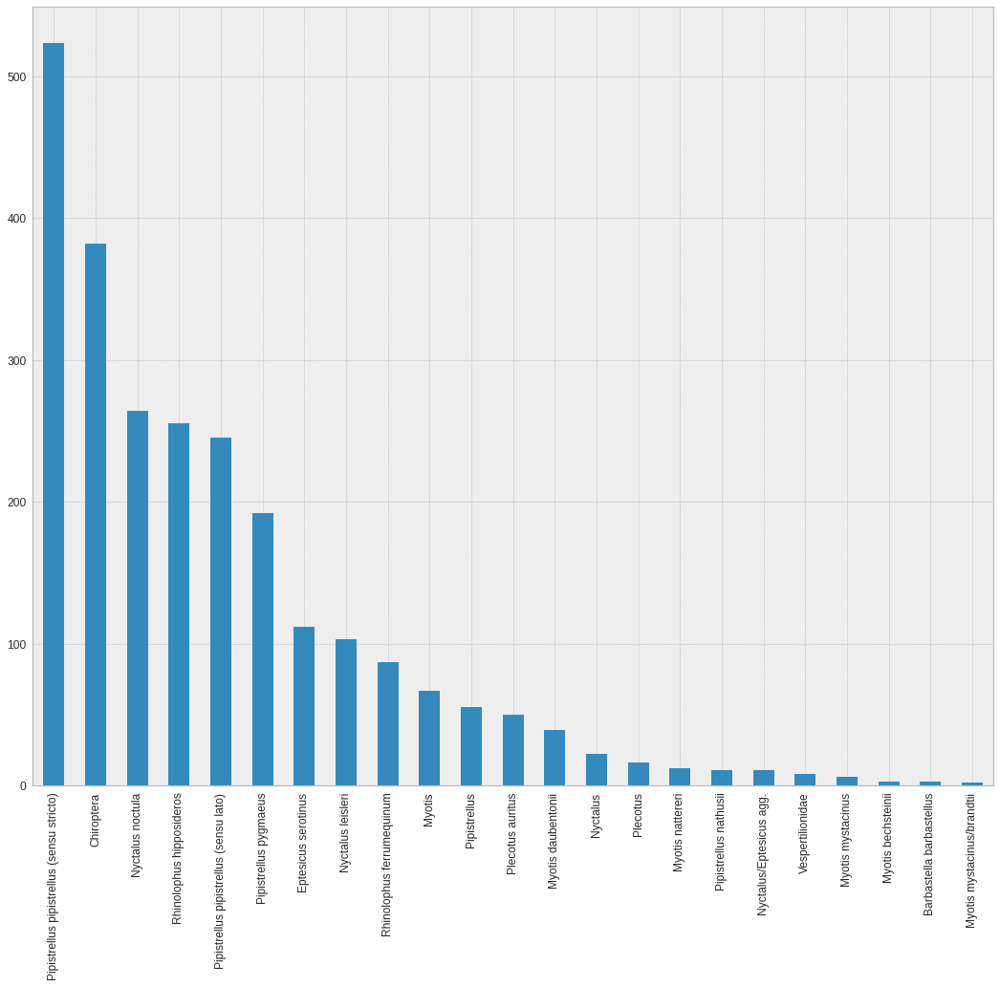

In [ ]:
bats["SCIENTIFIC"].value_counts().plot.bar()

In [ ]:
bats["SCIENTIFIC"].value_counts()

Pipistrellus pipistrellus (sensu stricto)    523
Chiroptera                                   382
Nyctalus noctula                             264
Rhinolophus hipposideros                     255
Pipistrellus pipistrellus (sensu lato)       245
Pipistrellus pygmaeus                        192
Eptesicus serotinus                          112
Nyctalus leisleri                            103
Rhinolophus ferrumequinum                     87
Myotis                                        67
Pipistrellus                                  55
Plecotus auritus                              50
Myotis daubentonii                            39
Nyctalus                                      22
Plecotus                                      16
Myotis nattereri                              12
Pipistrellus nathusii                         11
Nyctalus/Eptesicus agg.                       11
Vespertilionidae                               8
Myotis mystacinus                              6
Myotis bechsteinii  

As we can see, some bat species are really common (see Pipistrellus pipistrellus) whilst others barely have respresentation. Let's now look at other potentially interesting columns.

In [ ]:
bats["SEX_STAGE"].value_counts()

present                        1795
adult                           355
Present                         169
female                           25
male                             18
juvenile                         13
adult female                     11
juvenile male                     9
adult male                        9
feeding                           8
Female                            8
Male                              7
Adult                             5
dead male                         5
juvenile female                   4
imago                             4
Adult male                        4
dead female                       3
Adult female                      2
nursery colony                    2
dead                              2
hibernating                       2
dead adult                        1
immature or juvenile              1
immature                          1
pair                              1
breeding (sensitive record)       1
Immature Female             

In [ ]:
bats["RECORD_TYP"].value_counts()

field record                           1851
bat detector (not sensitive record)     589
found dead                                9
bat detector                              5
grounded                                  4
heard                                     4
museum specimen                           3
calling                                   1
photographed                              1
seen                                      1
Name: RECORD_TYP, dtype: int64

In [ ]:
bats["DATE_OF_RE"].value_counts()

1996 - 1997              41
26/06/2009               38
12/09/2012               30
07/08/2013               29
07/07/2013               24
                         ..
15/09/2010                1
Spring to Autumn 2011     1
02/07/2011                1
09/07/2011                1
09/04/2003                1
Name: DATE_OF_RE, Length: 943, dtype: int64

<AxesSubplot:>

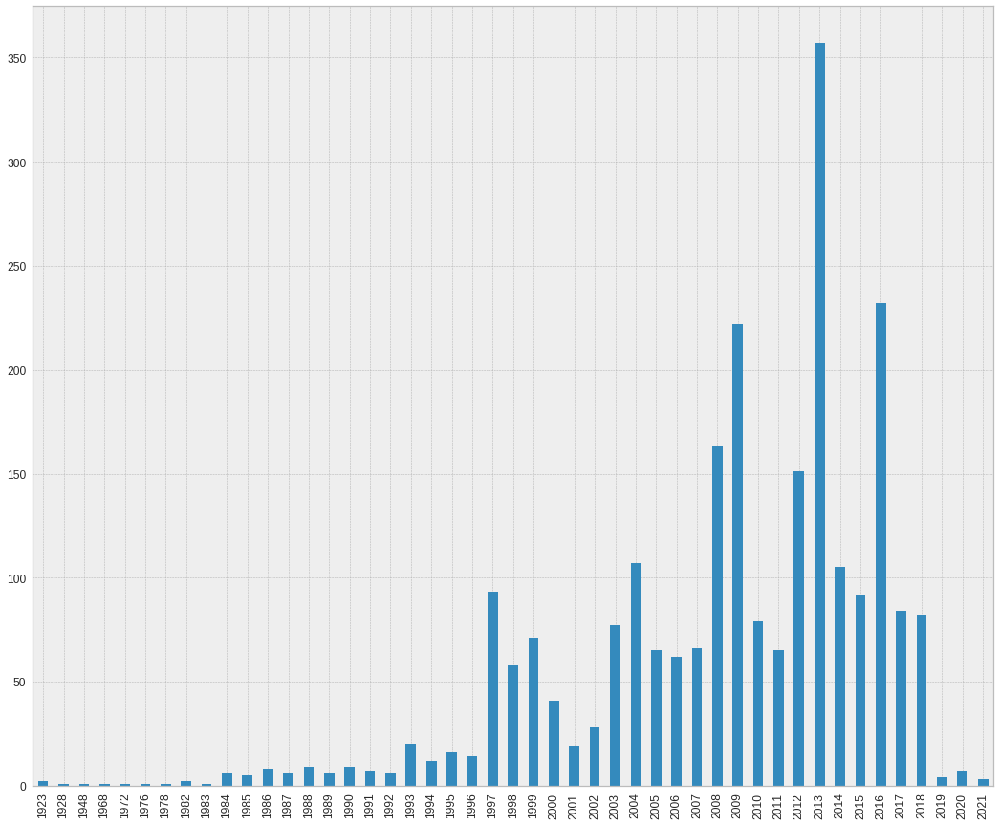

In [ ]:
bats["YEAR_DATE"].value_counts().sort_index().plot.bar()

In [ ]:
bats["YEAR_DATE"].value_counts()

2013    357
2016    232
2009    222
2008    163
2012    151
2004    107
2014    105
1997     93
2015     92
2017     84
2018     82
2010     79
2003     77
1999     71
2007     66
2005     65
2011     65
2006     62
1998     58
2000     41
2002     28
1993     20
2001     19
1995     16
1996     14
1994     12
1990      9
1988      9
1986      8
1991      7
2020      7
1987      6
1992      6
1989      6
1984      6
1985      5
2019      4
2021      3
1982      2
1923      2
1983      1
1948      1
1928      1
1972      1
1978      1
1968      1
1976      1
Name: YEAR_DATE, dtype: int64

SEX_STAGE and RECORD_TYP seem to be irrelevant. Just be having an overview on DATE_OF_RE we see that this column is quite inconsistent. Dates have different formats and we consider it to be really unreliable, so we will have to use the YEAR_DATE column instead.

Regarding the YEAR_DATE column, we see that the sightings really start in the 80's, so we will remove everything before 1980.

Finally, the coordinates are in a different Coordinate Reference System (CRS), so let's reload the dataset after converting them to the standard CRS. (We converted the coordinates with the tool provided by WDL)

In [ ]:
bats = pd.read_csv("bat_records_lcr.csv")

bats['Date'] = pd.to_datetime(bats['DATE_OF_RE'], infer_datetime_format=True, errors='coerce')
bats = bats[bats['Date'].dt.year > 1980]
bats.drop(columns=['COMMON_NAM','Unnamed: 0', 'RECORD_TYP', 'GRID_REF', 'ABUNDANCE', 'BRERC_STAT', 'EASTING', 'NORTHING', 'SEX_STAGE', 'YEAR_DATE', 'DATE_OF_RE'], inplace=True)
bats.dropna(inplace=True)
bats.set_index('Date', inplace=True)
bats

,SCIENTIFIC,LAT,LON,UNIQUE_NO
Date,,,,
1995-04-07,Pipistrellus pipistrellus (sensu lato),51.440208,-2.569692,499728.0
1998-01-03,Pipistrellus pygmaeus,51.499176,-2.642457,502903.0
1998-01-03,Pipistrellus pipistrellus (sensu stricto),51.499176,-2.642457,502902.0
1995-04-07,Nyctalus noctula,51.440208,-2.569692,499729.0
1994-06-06,Myotis daubentonii,51.440679,-2.651707,22474.0
...,...,...,...,...
2013-10-05,Pipistrellus pygmaeus,51.431020,-2.514916,1683309.0
2008-10-08,Rhinolophus hipposideros,51.440593,-2.651131,1238352.0
2013-01-06,Pipistrellus pygmaeus,51.444799,-2.549604,1683320.0


After removing the useless columns, let's see how the bat distribution looks in a map.

In [ ]:
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
locs = zip(bats['LAT'], bats['LON'])
names = bats['SCIENTIFIC']
for location, name in zip(locs, names):
    folium.Marker(location=location, popup=folium.Popup(name)).add_to(m)
m

In [ ]:
mh = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
HeatMap(data=zip(bats['LAT'], bats['LON']), radius=10).add_to(mh)
mh

We can see that the bats are quite scattered. There seems to be a higher contration around the central area of Bristol (you can zoom in and out of the map to check different levels of granularity).

Let's now check the distribution of the top 3 bat species to see how they behave.

In [ ]:
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
colors = ['red','blue', 'green']

for i,species in enumerate(['Pipistrellus pipistrellus (sensu stricto)','Chiroptera','Rhinolophus hipposideros']):
    locs = zip(bats[bats["SCIENTIFIC"] == species]['LAT'], bats[bats["SCIENTIFIC"] == species]['LON'])
    names = bats['SCIENTIFIC']
    for location, name in zip(locs, names):
        folium.Marker(location=location, popup=folium.Popup(name), icon=folium.Icon(color=colors[i])).add_to(m)
m

As we can see, there are clear differences between bat populations. One thing we notice straight away is that there are a lot of sightings taking place in rivers and green areas. The Rhinolophus hipposideros seems to be more localized around outer areas and green zoes, whereas the two most frequent bat species, Pipistrellus pipistrellus (sensu stricto) and Chiroptera are also present inside the metropoli. 

To give one final overview of the bats, let's cluster the markers to see where the biggest concentrations are.

In [ ]:
mc = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
marker_cluster = MarkerCluster().add_to(mc)
locs = zip(bats['LAT'], bats['LON'])
names = bats['SCIENTIFIC']
for location, name in zip(locs, names):
    folium.Marker(location=location, popup=folium.Popup(name), icon=folium.Icon(color="blue")).add_to(marker_cluster)
mc

This dataset is going to be the center piece of our solution and we will use the other dataset as an aggregate in a creative way to build our model.

In [ ]:
gbats = gpd.GeoDataFrame(bats, geometry=gpd.points_from_xy(bats['LON'], bats['LAT']), crs = "epsg:4326")
gbats = gbats.to_crs("EPSG:27700")

#### Dark corridors

In [ ]:
darkcorridors = pd.read_csv("/content/datasets/dark_corridors.csv")
darkcorridors

,Unnamed: 0,PRIMARYCOD,PRIMARYHAB,UKHABCODE,UKHABNAME,PHT,POTENTIALP,P1CODE,ALPHAP1COD,PHASE1,...,BRERCNOTES,HECTARES,BRERCREF,BLISS,TARGETSCOR,V,TEMP,MODIFYBY,DATEMODIFY,geometry
0,0,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,Potential,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,...,NaN,0.0,65418.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (362565.49700000044 170991.1280000005 0)
1,1,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,Potential,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,...,NaN,0.0,65419.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (362572.125 170998.58400000073 0)
2,2,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,Potential,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,...,NaN,0.0,65420.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (362585.38100000005 170995.26999999955 0)
3,3,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,Potential,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,...,NaN,0.0,65421.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (362633.4330000002 170970.41599999927 0)
4,4,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,Potential,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,...,NaN,0.0,65422.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (362480.1639999999 171048.2929999996 0)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,59,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,Potential,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,...,NaN,0.0,65477.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (357890.68900000025 170105.90300000086 0)
60,60,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,Potential,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,...,NaN,0.0,65478.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (357875.6289999997 170109.52500000037 0)
61,61,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,Potential,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,...,NaN,0.0,65479.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (357868.3849999998 170111.2410000004 0)
62,62,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,Potential,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,...,NaN,0.0,65480.0,WSP May 2021,0,t,t,TimC,2022-02-21T00:00:00+00:00,POINT Z (357856.375 170114.67200000025 0)


This dataset is by far the biggest in terms of columns, with 63. However, we noticed that most of them are completely irrelevant, as they contain the same value or empty. Let's remove all of this duplicate columns.

In [ ]:
for col in darkcorridors.columns:
    if len(darkcorridors[col].unique()) == 1:
        darkcorridors = darkcorridors.drop(col, axis=1)

In [ ]:
darkcorridors

,Unnamed: 0,PRIMARYCOD,PRIMARYHAB,UKHABCODE,UKHABNAME,POTENTIALP,P1CODE,ALPHAP1COD,PHASE1,UKHABSECC,UKHABSECN,BRERCREF,geometry
0,0,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,10,Scattered scrub,65418.0,POINT Z (362565.49700000044 170991.1280000005 0)
1,1,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,10,Scattered scrub,65419.0,POINT Z (362572.125 170998.58400000073 0)
2,2,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,10,Scattered scrub,65420.0,POINT Z (362585.38100000005 170995.26999999955 0)
3,3,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,10,Scattered scrub,65421.0,POINT Z (362633.4330000002 170970.41599999927 0)
4,4,Ppht SS,Scrub - scattered,g:10,Grassland: Scattered scrub,"Potentially as noted as scrub, therefore until...",SS,A2.2,Scrub - scattered,10,Scattered scrub,65422.0,POINT Z (362480.1639999999 171048.2929999996 0)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,59,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,11,Scattered trees,65477.0,POINT Z (357890.68900000025 170105.90300000086 0)
60,60,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,11,Scattered trees,65478.0,POINT Z (357875.6289999997 170109.52500000037 0)
61,61,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,11,Scattered trees,65479.0,POINT Z (357868.3849999998 170111.2410000004 0)
62,62,Ppht SBW,Broadleaved Parkland/scattered trees,g: 11,Grassland: Scattered trees,"Potentially as noted as parkland, therefore un...",SBW,A3.1,Broadleaved Parkland/scattered trees,11,Scattered trees,65480.0,POINT Z (357856.375 170114.67200000025 0)


We are not interested in most of these values, as they are just descriptive of the conditions of the darkcorridor and there are not that many dark corridors. The geometries provided are single points.Let's instead of having points extend them 100m and show the location of said corridors in a map so we can have a fair understanding of their area and position.

In [ ]:
darkcorridors['geometry'] = gpd.GeoSeries.from_wkt(darkcorridors['geometry'], crs='EPSG:27700')
gdf2 = gpd.GeoDataFrame(darkcorridors, crs = "EPSG:27700")
gdf2['geometry'] = gdf2.geometry.buffer(100)
gdf2 = gdf2.to_crs("EPSG:4326")

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in gdf2.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    geo_j.add_to(m)
m

The dark corridors seem to be quite displaced from the actual bat populations. Let's plot them together and compare them.

In [ ]:
locs = zip(bats['LAT'], bats['LON'])
names = bats['SCIENTIFIC']
for location, name in zip(locs, names):
    folium.Marker(location=location, popup=folium.Popup(name), icon=folium.Icon(color="red")).add_to(m)
m

In [ ]:
# Turn group of polygons into single multipolygon
gdf2 = gdf2.to_crs("EPSG:27700")
dcorridors = gdf2.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if dcorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/dcorridors.area * 1000)

Bats per km: 0.0


We check visually and also check if these areas contain bats. These dark corridors seem to be completely off having no bats and we will discard them preliminary for our solution.

#### Green alleys

In [ ]:
greenalleys = pd.read_csv("/content/datasets/green_alley_v2.csv", on_bad_lines='skip')
greenalleys

,Unnamed: 0,Log_no,date,Alley,CentralGridRef,LAT,LON
0,0,001,16/01/11,Bishop Road Path,ST58537592,51.480706,-2.598565
1,1,002,16/01/11,Bramble Lane,ST55327527,51.474617,-2.644704
2,2,003,16/01/11,Clayfield Road Path,ST62167118,51.438343,-2.545786
3,3,004,16/01/11,Cote Drive,ST57077600,51.481316,-2.619597
4,4,005,16/01/11,Cote House Lane,ST57047612,51.482393,-2.620044
...,...,...,...,...,...,...,...
191,192,204,16/09/37,All Saints Lane,ST58887299,51.454388,-2.593183
192,193,205,16/09/37,All Saints Court,ST58887301,51.454568,-2.593186
193,194,206,16/09/37,Exchange Avenue,ST58857297,51.454206,-2.593613
194,195,207,16/12/27,Cowmead Walk,ST60167446,51.467696,-2.574929


This dataset contains the green alleys. We extend them again 100m and plot them:

In [ ]:
ggreen = gpd.GeoDataFrame(greenalleys, geometry=gpd.points_from_xy(greenalleys['LON'], greenalleys['LAT']), crs = "epsg:4326")
ggreen = ggreen.to_crs("EPSG:27700")
ggreen['geometry'] = ggreen.geometry.buffer(100)
ggreen = ggreen.to_crs("EPSG:4326")

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in ggreen.iterrows():
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['Alley']).add_to(geo_j)
    geo_j.add_to(m)
m

In [ ]:
ggreen = ggreen.to_crs("EPSG:27700")
gcorridors = ggreen.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if gcorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/gcorridors.area * 1000)

Bats per km: 0.006203477457889444


We check if these areas contain bats. These green alleys seem to have 0.006 bats per km which is fewer than expected.

#### Green alley species

In [ ]:
greenalleyspecies = pd.read_csv("/content/datasets/green_alley_species_v2.csv")
greenalleyspecies = greenalleyspecies[pd.to_numeric(greenalleyspecies['LAT'], errors='coerce').notnull()]
greenalleyspecies

,Unnamed: 0,Scientific_Name,Common_Name,Grid_Ref,LAT,LON,Date_of_Record,Abundance,Sex_Stage,Record_Type,BERC_Status,Year_Date,Unique_No
0,0,Acer campestre,Field Maple,ST52707788,51.497869,-2.682775,20.05.15,present,present,field record,NaN,2015.0,-1.539512e-48
1,1,Acer pseudoplatanus,Sycamore (tree),ST52707788,51.497869,-2.682775,20.05.15,present,present,field record,NaN,2015.0,-1.539512e-48
2,2,Alliaria petiolata,Garlic Mustard,ST52707788,51.497869,-2.682775,20.05.15,present,present,field record,NaN,2015.0,-1.539512e-48
3,3,Anthriscus sylvestris,Cow Parsley,ST52707788,51.497869,-2.682775,20.05.15,present,present,field record,NaN,2015.0,-1.539512e-48
4,4,Arctium minus,Lesser Burdock,ST52707788,51.497869,-2.682775,20.05.15,present,present,field record,NaN,2015.0,-1.539512e-48
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5980,5980,Snails,a snail (unidentified),ST69887288,51.454093,-2.434869,23.07.15,present,present,field record,NaN,2015.0,-7.993606e-15
5981,5981,Syrphidae,a hoverfly (unidentified),ST69887288,51.454093,-2.434869,23.07.15,present,present,field record,NaN,2015.0,-7.993606e-15
5982,5982,Taraxacum officinale agg.,Dandelion,ST69887288,51.454093,-2.434869,23.07.15,present,present,field record,NaN,2015.0,-7.993606e-15
5983,5983,Ulmus,an elm (unidentified),ST69887288,51.454093,-2.434869,23.07.15,present,present,field record,NaN,2015.0,-7.993606e-15


This dataset contains the species of plants in the green alleys. We extend them again 100m and plot them:

In [ ]:
gsgreen = gpd.GeoDataFrame(greenalleyspecies, geometry=gpd.points_from_xy(greenalleyspecies['LON'], greenalleyspecies['LAT']), crs = "epsg:4326")
gsgreen = gsgreen.to_crs("EPSG:27700")
gsgreen['geometry'] = gsgreen.geometry.buffer(100)
gsgreen = gsgreen.to_crs("EPSG:4326")

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in gsgreen.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['Scientific_Name']).add_to(geo_j)
    geo_j.add_to(m)
m

In [ ]:
# Turn group of polygons into single multipolygon
gsgreen = gsgreen.to_crs("EPSG:27700")
gscorridors = gsgreen.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if gscorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/gscorridors.area * 1000)

Bats per km: 0.017792977586427384


We check if these areas contain bats. Around these green species there are 0.017 bats per km which is higher than in the green alleys.

#### Noctua Pronuba

In [ ]:
noctua = pd.read_csv("/content/datasets/noctua_pronuba_v2.csv")
noctua

,Unnamed: 0,Scientific_Name,Common_Name,Grid_Ref,LAT,LON,Date_of_Record,Abundance,Sex_Stage,Record_Type,Year_Date,Unique_No
0,0,Noctua pronuba,Large Yellow Underwing,ST519755,51.476403,-2.693973,15/07/2000,3,Adult,trapped at mercury vapour light,2000,4.629467e-317
1,1,Noctua pronuba,Large Yellow Underwing,ST521758,51.479118,-2.691135,28/07/2001,7,adult,trapped at mercury vapour light,2001,7.023117e-317
2,2,Noctua pronuba,Large Yellow Underwing,ST521758,51.479118,-2.691135,02/09/2001,5,adult,trapped at mercury vapour light,2001,1.195008e-317
3,3,Noctua pronuba,Large Yellow Underwing,ST521758,51.479118,-2.691135,18/08/1999,3,adult,trapped at mercury vapour light,1999,5.145003e-317
4,4,Noctua pronuba,Large Yellow Underwing,ST521758,51.479118,-2.691135,23/06/2001,1,adult,trapped at mercury vapour light,2001,2.749078e-317
...,...,...,...,...,...,...,...,...,...,...,...,...
1829,1829,Noctua pronuba,Large Yellow Underwing,ST641688,51.417071,-2.517635,17/06/2018,5,present,trapped at mercury vapour light,2018,1.063246e-314
1830,1830,Noctua pronuba,Large Yellow Underwing,ST6493172615,51.451425,-2.506065,28/07/2011,present,adult,trapped at actinic light,2011,3.628892e-317
1831,1831,Noctua pronuba,Large Yellow Underwing,ST6493673270,51.457314,-2.506058,07/07/2019,present,present,field record,2019,9.571143e-318
1832,1832,Noctua pronuba,Large Yellow Underwing,ST6575,51.472873,-2.505309,12/08/2001,Present,Present,netted,2001,5.276552e-317


This dataset contains the sightings of Large Yellow Underwing moth, a common food source for bats. First, we plot a heatmap to see where are these located:

In [ ]:
mh = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
# Add a heatmap to the base map
HeatMap(data=zip(noctua['LAT'], noctua['LON']), radius=10).add_to(mh)
mh

Most of them are concentrated in parks. Some of them are concentrated inside the city, probably attracted by the light. These areas in the city are most of them near a park.

In [ ]:
gmoth = gpd.GeoDataFrame(noctua, geometry=gpd.points_from_xy(noctua['LON'], noctua['LAT']), crs = "epsg:4326")
gmoth = gmoth.to_crs("EPSG:27700")
gmoth['geometry'] = gmoth.geometry.buffer(100)
gmoth = gmoth.to_crs("EPSG:4326")

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in gmoth.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    geo_j.add_to(m)
m

In [ ]:
# Turn group of polygons into single multipolygon
gmoth = gmoth.to_crs("EPSG:27700")
mcorridors = gmoth.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if mcorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/mcorridors.area * 1000)

Bats per km: 0.03852952098775548


We check if these areas contain bats. 100m around the moths there are 0.038 bats per km which is the highest among other areas like green alleys or dark corridors.

#### Streetlights

In [ ]:
streetlights = pd.read_csv("/content/datasets/streetlights_2022.csv")
streetlights

,Unnamed: 0,Lamp,Burn_Hours,Ratio,Site_Name,Site_Code,Parent_ID,Par_Plot,Child_Plot,Ward,Customer,Easting,Northing,geometry
0,0,AXIA 24 LED 350mA,2965,35/18,Gladstone Street To George And Dragon La,4512585,P002,11001.01,10001.11,St George West,PTSD - HIGHWAYS,361610.10,173417.60,POINT (361610.1 173417.6)
1,1,AXIA 16 LED 350mA,2965,35/18,Barker Walk/highett Drive Footpaths,4512622,P004,11001.01,10001.11,Lawrence Hill,PTSD - HIGHWAYS,360239.00,173976.00,POINT (360239 173976)
2,2,AXIA 16 LED 350mA,2965,35/18,Barker Walk/highett Drive Footpaths,4512622,P004A,11001.02,10001.12,Lawrence Hill,PTSD - HIGHWAYS,360223.32,173972.53,POINT (360223.32 173972.53)
3,3,AXIA 16 LED 350mA,2965,35/18,Barker Walk/highett Drive Footpaths,4512622,P004B,11001.03,10001.13,Lawrence Hill,PTSD - HIGHWAYS,360211.74,173969.00,POINT (360211.74 173969)
4,4,AXIA 16 LED 350mA,2965,35/18,Barker Walk/highett Drive Footpaths,4512622,P005,11001.04,10001.14,Lawrence Hill,PTSD - HIGHWAYS,360246.00,173992.00,POINT (360246 173992)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36894,36894,70W SON-T Lamp Ext. Ign.,4156,70/35,Withywood Park,WITHPA,H002,11001.08,10001.18,Hartcliffe & Withywood,PTSD - PARKS,356570.00,167724.00,POINT (356570 167724)
36895,36895,AXIA 16 LED 350mA,2965,35/18,Withywood Park,WITHPA,P006,11001.09,10001.19,Hartcliffe & Withywood,PTSD - PARKS,356789.55,168034.24,POINT (356789.55 168034.24)
36896,36896,70W SON-E Lamp Ext. Ign.,2965,35/18,Withywood Park,WITHPA,P005,11001.10,10001.20,Hartcliffe & Withywood,PTSD - PARKS,356605.40,167883.49,POINT (356605.4 167883.49)
36897,36897,AXIA 16 LED 350mA,2965,35/18,Withywood Park,WITHPA,P002,11001.11,10001.21,Hartcliffe & Withywood,PTSD - PARKS,356728.60,167934.98,POINT (356728.6 167934.98)


First thing we notice is the huge amount of streetlights there are in Bristol. Aside from the location, which we will later plot, this dataset contains some information regarding the types of lights and geographical information. Let's give it a brief look.

In [ ]:
streetlights["Customer"].value_counts()

PTSD - HIGHWAYS         34190
N&HS - HOUSING            896
PTSD - PARKS              673
PTSD - CAR PARKS          420
PTSD - DOCKS              410
DEVELOPER                 167
PTSD - CYCLE TEAM          97
BCC Traffic Managemt       15
N&HS - NON-ADOPT FPS        9
CORPORATE RESOURCES         8
PTSD - TRAF.SIGNALS         4
BCC Surveyors Dept          4
BCC ESTATES (Hsng)          3
N&hs - FLOODLIGHTS          2
Housing  (NH)               1
Name: Customer, dtype: int64

In [ ]:
streetlights["Ward"].value_counts()

Avonmouth & Lawrence Weston    2549
Lawrence Hill                  2536
Central                        2063
Hengrove & Whitchurch Park     1962
Westbury-on-Trym & Henleaze    1559
Hartcliffe & Withywood         1461
Filwood                        1430
Ashley                         1354
Eastville                      1282
Stoke Bishop                   1190
Henbury & Brentry              1141
Brislington East               1133
Southmead                      1129
Lockleaze                      1051
Stockwood                      1039
Southville                      980
Easton                          964
Frome Vale                      955
Horfield                        933
Bishopsworth                    906
Windmill Hill                   895
Clifton                         822
Bedminster                      816
Hotwells & Harbourside          797
Knowle                          762
Brislington West                747
St George Central               726
Hillfields                  

These two columns are the most interesting for us. As we can see, most of the streetlights are part of highways. There is also a column, "Ward", containing the neighbourhoods where the lights are located. We will use this information later on for our solution.

Let's now cluster the lights and plot a subset of them to have an overview of the spacial location in the city of Bristol. (We plot a subset due to RAM limitations)

In [ ]:
streetlights['geometry'] = gpd.GeoSeries.from_wkt(streetlights['geometry'], crs='EPSG:27700')
gdf = gpd.GeoDataFrame(streetlights)
gdf['geometry'] = gdf.geometry.buffer(50)
gdf = gdf.to_crs("EPSG:4326")

sample = gdf[:1000]
mh = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
folium.GeoJson(sample.to_crs(epsg=4326), tooltip=folium.GeoJsonTooltip(['Lamp', 'Ratio', 'Site_Name', 'Customer'])).add_to(mh)
mh

This plot is a bit special: 

If you zoom in you will see that we created circles around the centre points of the lights. This circles are exactly 50 metres. 

This is inspired by the paper [Evidence for distance and illuminance thresholds in the effects of artificial lighting on bat activity](https://linkinghub.elsevier.com/retrieve/pii/S0169204618300677). In this paper, the authors show that bats avoid streetlight at up to 50 meters. We will make use of this parameter later on in our solution.

In [ ]:
# Turn group of polygons into single multipolygon
gdf = gdf.to_crs("EPSG:27700")
lcorridors = gdf.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if lcorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/lcorridors.area * 1000)

Bats per km: 0.005555863706076458


We check if these areas contain bats. 0.005 bats per km which is the lowest among another areas like green alleys or dark corridors. This confirms that bats avoid streetlight up to 50m.

**Lights per land use**

Lets see the how many lights are depending if it is a commercial area or an industrial area. Using OpenStreetMaps data we see commercial and residential area differences 
in lighting and evaluate which sites might need a certain level of nighttime lighting.

In [ ]:
import osmnx as ox

In [ ]:
# get all building footprints in some neighborhood
place = "Bristol, England"
tags = {"landuse": ['residential']}
residentials = ox.geometries_from_place(place, tags)
residentials.shape

(248, 27)

In [ ]:
# get all building footprints in some neighborhood
place = "Bristol West, England"
tags = {"landuse": ['commercial']}
commercials = ox.geometries_from_place(place, tags)
commercials.shape

(125, 31)

We plot these areas, commercial areas are in blue (there are few) and residential areas are in red.

In [ ]:
import folium
import geopandas as gpd
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in residentials.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'red'})
    geo_j.add_to(m)
for _, r in commercials.iterrows():
    sim_geo2 = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j2 = sim_geo2.to_json()
    geo_j2 = folium.GeoJson(data=geo_j2)
    geo_j2.add_to(m)
m

We just check the first 1000 lights, due to RAM limitations.

In [ ]:
# Turn group of polygons into single multipolygon
ss = gpd.GeoDataFrame(streetlights[:1000])
ss = ss.to_crs("EPSG:27700")
residentials = residentials.to_crs("EPSG:27700")
uresidentials = residentials.geometry.unary_union
b = 0
for _, s in ss.iterrows():
  if uresidentials.contains(s.geometry):
    b = b + 1
print('Lights per km:', b/uresidentials.area * 1000)

Lights per km: 0.0030645829418736157


In [ ]:
# Turn group of polygons into single multipolygon
ss = gpd.GeoDataFrame(streetlights[:1000])
ss = ss.to_crs("EPSG:27700")
commercials = commercials.to_crs("EPSG:27700")
ucommercials = commercials.geometry.unary_union
b = 0
for _, s in ss.iterrows():
  if uresidentials.contains(s.geometry):
    b = b + 1
print('Lights per km:', b/ucommercials.area * 1000)

Lights per km: 0.13076415117227874


Commercial areas(0.13076415117227874 lights/km) have more lights (in the choosen 1000 sample). Stakeholders should take into account this.

#### Wildlife corridors

In [ ]:
wildlifecorridors = pd.read_csv("/content/datasets/wildlife_corridors.csv")
wildlifecorridors

,Unnamed: 0,OBJECTID,WNS_ID,WNS_NAME,PERIMETER,PARKS_NATC,SPECIES_LB,SPECIES_NB,SPECIES_NN,SPECIES_LN,HABITAT_NB,HABITAT_LB,SHAPE_AREA,SHAPE_LEN,geometry
0,0,1,WNS_BCC_17,Colliters Brook South,0.0,0.0,0,0,0,0,0,0,0.0,0.0,POLYGON ((356120.95999999996 170129.2200000006...
1,1,2,WNS_BCC_18,Railway line near Bedminster Down,0.0,0.0,0,3,7,0,1,0,0.0,0.0,MULTIPOLYGON (((356979.62200000044 170605.4719...
2,2,3,WNS_BCC_19,South Bristol Crematorium,0.0,0.0,0,0,0,1,1,0,0.0,0.0,POLYGON ((356610.3820000002 170072.62600000016...
3,3,4,WNS_BCC_20,Ilchester Cresent Open Sapce,0.0,0.0,0,0,0,0,0,0,0.0,0.0,POLYGON ((357727.7000000002 170467.65000000037...
4,4,5,WNS_BCC_21,Bedminster Down Allotments,0.0,0.0,0,0,0,0,0,0,0.0,0.0,POLYGON ((357494.4000000004 170392.08000000007...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
333,333,334,WNS_BCC_334,Meg Thatchers Green,0.0,0.0,0,0,4,0,0,0,0.0,0.0,"POLYGON ((363472.25 173316.55000000075, 363476..."
334,334,335,WNS_BCC_335,Stibbs Hill Allotments and adjacent land,0.0,0.0,0,0,1,0,0,0,0.0,0.0,"MULTIPOLYGON (((363534.75 173378.65000000037, ..."
335,335,336,WNS_BCC_336,Railway land Easton Rd to Stapleton Rd,0.0,0.0,1,2,1,0,0,0,0.0,0.0,POLYGON ((360743.4000000004 174509.84999999963...
336,336,337,WNS_BCC_337,Land around Boiling Wells,0.0,0.0,2,3,2,1,0,0,0.0,0.0,"POLYGON ((360097.9000000004 175681.5, 360098.4..."


This dataset contains the wildlife corridors. Lets plot them:

In [ ]:
wildlifecorridors['geometry'] = gpd.GeoSeries.from_wkt(wildlifecorridors['geometry'], crs='EPSG:27700')
gdf7 = gpd.GeoDataFrame(wildlifecorridors)
gdf7 = gdf7.to_crs("EPSG:4326")

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
for _, r in gdf7.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['WNS_NAME']).add_to(geo_j)
    geo_j.add_to(m)
m

In [ ]:
# Turn group of polygons into single multipolygon
gdf7 = gdf7.to_crs("EPSG:27700")
wcorridors = gdf7.geometry.unary_union
b = 0
for _, s in gbats.iterrows():
  if wcorridors.contains(s.geometry):
    b = b + 1
print('Bats per km:', b/wcorridors.area * 1000)

Bats per km: 0.007085269424323183


We check if these areas contain bats. These green alleys seem to have 0.007 bats per km which is fewer than expected, similar to the case of green alleys.

### Modelling

We spent quite some time thinking about the modelling part. In the end we came up with a solution based on a really simple concept that can then be scaled and adapted to many different scenarios and variables. Let me guide you through it!



#### Solution overview

Our solution is based on graph theory. It can be described in 4 core steps:



1.   Creating the nodes of the graph
2.   Creating the edges of the graph
3.   Weighting the edges of the graph
4.   Computing the Minimum Spanning Tree (MST)

The intuition behind our solution is the following:

We want to create a graph, where the nodes are bats (we will talk about further modifications later on) and the edges represent the safe pathways between bats. 

This edges will be weighted in different ways. 

By computing the Minimal Spanning Tree, which is the minimal representation of the whole graph, we can effectively generate meaningful and optimal pathways for the bats to navigate.

The key to our algorithm is 1. Node selection and placement and 2. Weight formula for the edges.

It is easier if we start with a simple example and then work our way up into more complex representations of the environment. Off we go!



#### Baseline solution - A (clustered) tree of bats

Our baseline and most simple solution will consist on a graph where the nodes are the locations of the bats and the edges are weighted with the distance between nodes. 

We will then compute the Minimal Spanning Tree and create the paths between bat populations with the shortest inter-distance between them.

To simplify our baseline solution, we will first cluster the bats to reduce the number of nodes and make it easier to understand. 

First we compute the optimal number of clusters between 2 and 12. To do this, we use a combination of the Elbow method and the Distortion Score.

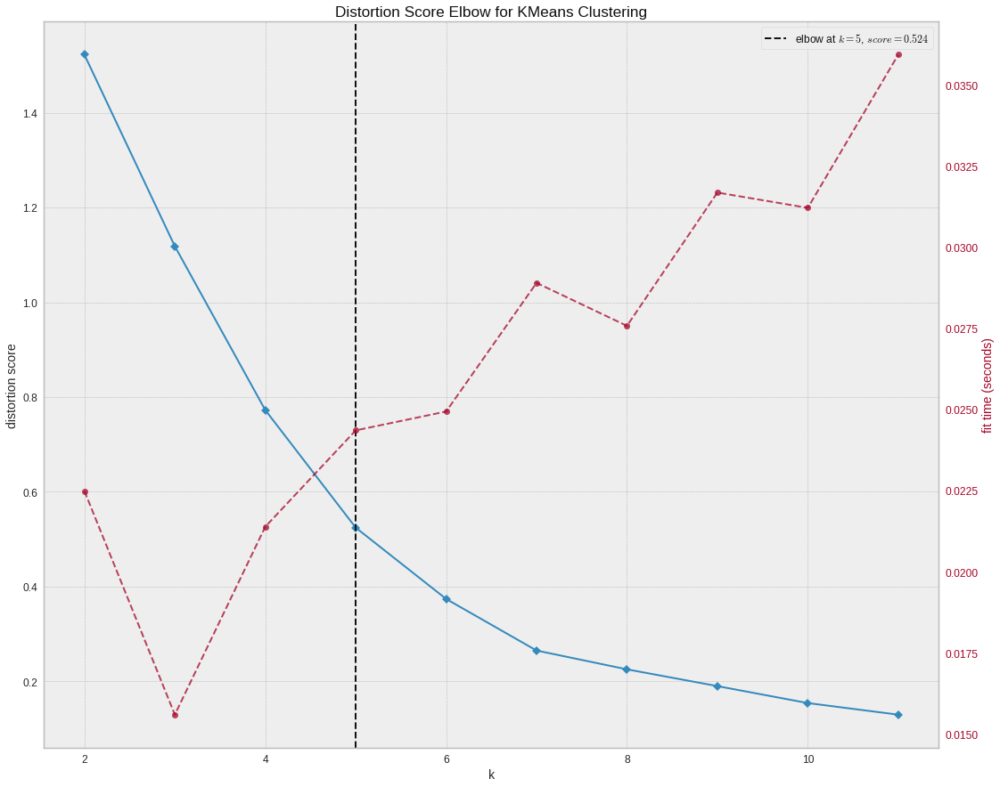

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,12))
 
visualizer.fit(bats[["LAT","LON"]])        
visualizer.show()  

The optimal number of clusters (see top right) is 5, so we will now run K-Means on 5 clusters and plot them.

In [ ]:
kmeans = KMeans(n_clusters=5)
kmeans.fit(bats[["LAT","LON"]])
kmeans.cluster_centers_

array([[51.47802483, -2.6233337 ],
       [51.49113753, -2.53940111],
       [51.454701  , -2.83338057],
       [51.45103044, -2.56547389],
       [51.42022215, -2.63550381]])

Here are the coordinates of the cluster centers. Let's see them in a map

In [ ]:
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
locs = kmeans.cluster_centers_
for location in locs:
    folium.Marker(location=location).add_to(m)
m

Let's now map those nodes to a integer value to make it simpler

In [ ]:
nodes = {i:node for i, node in enumerate(kmeans.cluster_centers_)}
nodes

{0: array([51.47802483, -2.6233337 ]),
 1: array([51.49113753, -2.53940111]),
 2: array([51.454701  , -2.83338057]),
 3: array([51.45103044, -2.56547389]),
 4: array([51.42022215, -2.63550381])}

Next step is computing the edges. Here we simply create a fully connected graph by building an edge for each combinations of nodes.

In [ ]:
combinations = list(itertools.combinations(list(nodes.keys()), 2))
combinations

[(0, 1),
 (0, 2),
 (0, 3),
 (0, 4),
 (1, 2),
 (1, 3),
 (1, 4),
 (2, 3),
 (2, 4),
 (3, 4)]

Next, we calculate the weights of said edges. For our baseline model this will be the distance between nodes.

In this particular case we will be using the Haversine distance as our distance metric. We use this metric instead of the more common Euclidean distance due to the physical properties of the Earth. This metric takes into account the curvature and will output a more accurate value. This value will be in km.

In [ ]:
graph_distances = list(map(lambda element: haversine(nodes[element[0]], nodes[element[1]]), combinations))
edges = []
for combination, distance in zip(combinations, graph_distances):
    edges.append([combination[0], distance, combination[1]])

edges

[[0, 5.991935710947962, 1],
 [0, 14.779615179677107, 2],
 [0, 5.007551347854333, 3],
 [0, 6.482468100213507, 4],
 [1, 20.760678414333317, 2],
 [1, 4.811482007431073, 3],
 [1, 10.320809943804065, 4],
 [2, 18.568300564813185, 3],
 [2, 14.241669850377207, 4],
 [3, 5.941413139761854, 4]]

Here we have our first and most simple graph. This graph is represented in the following way:



*   The graph is represented as a list of n elements [E0,E1,E2,...En], where n is the number of edges. 
*   Each edge is represented as a list of 3 elements [A,E,B], where A is the origin node, B is the target node and E is the cost of the edge going from a to b. 
*    Our graphs are always bidirected. This means that an edge goes in both directions. The path from B to A through E can also be described as [A,E,B]

Enough theory, let's create some auxiliary functions and convert this graph into an igraph and see how it actually looks on a map.






In [ ]:
def plot_graph(graph:"igraph.Graph") -> None:
    """
    Plots a given graph.
    :param graph: (igraph.Graph) Graph representation 
    """
    nodes = list(graph.vs['Coord'])
    edges = list(graph.get_edgelist())
    m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
    for location in nodes:
        folium.Marker(location=location).add_to(m)
    for i in edges:
        pairLine = [graph.vs[i[0]]['Coord'], graph.vs[i[1]]['Coord']]
        folium.PolyLine(pairLine, color='red').add_to(m)
    return m

def create_igraph(nodes:dict, edges:list) -> "igraph.Graph":
    """
    Creates an igraph object from a given set of nodes and edges.
    :param nodes: (dict) Dictionary containing the mapping between nodes and their coordinates
    :param edges: (list) List containing all the edges of the graph and their weights
    :return: (igraph.Graph) Returns an igraph.Graph representation of the graph
    """
    g = ig.Graph()
    for n in nodes:
      g.add_vertex(n);
      g.vs[n]['Lat'] = nodes[n][0]
      g.vs[n]['Lon'] = nodes[n][1]
      g.vs[n]['Coord'] = [nodes[n][0], nodes[n][1]]
    for e in edges:
      if len(e)>3:
        raise Exception("Error while parsing edges")
      g.add_edge(e[0],e[2], weight=e[1])
    return g

def compute_mst(graph:"igraph.Graph") -> "igraph.Graph":
    """
    Computes the Minimum Spanning Tree (MST) of a given graph
    :param graph: (igraph.Graph) Graph representation 
    :return: (igraph.Graph) Returns an igraph.Graph representation of the graph
    """
    spanning_tree = graph.spanning_tree(weights=graph.es['weight'], return_tree=True)
    return spanning_tree

Let's first plot the fully connected graph

In [ ]:
graph = create_igraph(nodes, edges)
plot_graph(graph)

And let's now compute the Minimum Spanning Tree (MST) and plot it

In [ ]:
mst = compute_mst(graph)
plot_graph(mst)

It works! This would be our first rudimentary corridor distribution. 

With this as a baseline, let's now start complicating things and adding more variables to the solution.

Lights on!

#### Illuminated tree of bats

In this project we are looking into creating DARK corridors for the bats, so we must take the lights into account. Let's first start with the same baseline, usig the clusters of bats as our starting node distribution.

In [ ]:
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
locs = kmeans.cluster_centers_
for location in locs:
    folium.Marker(location=location).add_to(m)
m

This is when the interesting part starts. In order to include the lights, we had the following idea:

Given two nodes of the graph, let's say A and B, we want to create a straight Dark corridor from A to B and somehow include the lights. To do so, we will first isolate all of the lights that have a light center within 25m from the corridor segment that is formed between A and B. This will give us all of the lights that would have an impact on our Dark corridor. Let's create some more functions and see it in action.

PD: We use 25m based on the paper we mentioned before. Bats seem to be affected by light up to 50m, so we decided to use a middle value that already removes most of the lights in the area (there are tens of thousands of lights in Bristol) whilst keeping the value consistent with the literature. 

In [ ]:
light_distance = 25 #distance in m
    

def get_combinations(combinations, points, nodes, dist):
    combination_distances = []
    for a,b in combinations:
        distance = get_distances(nodes[a],nodes[b],points,dist)
        combination_distances.append([a,distance,b])

    return combination_distances

def get_distances(a, b, points, dist):
    distances = []
    for point in points:
        distance = distance_to_segment(a,b,point)
        if distance < dist:
            distances.append(point)
    return distances

def distance_to_segment(p1,p2,p3):
    l2 = np.sum((p1-p2)**2)

    t = np.sum((p3 - p1) * (p2 - p1)) / l2

    if t > 1 or t < 0:
        return np.inf
    else:
        t = max(0, min(1, np.sum((p3 - p1) * (p2 - p1)) / l2))
        projection = p1 + t * (p2 - p1)
        return haversine(projection, p3) * 1000



Now we can compute all the lights that are between nodes!

In [ ]:
lights = pd.read_csv("lights2022v2.csv")
light_points = lights.apply(lambda x : [x.LAT, x.LON], axis=1).tolist()
lights_between_nodes = get_combinations(combinations, light_points, nodes, light_distance)
lights_between_nodes

Let's see how this would look in the map with an example

In [ ]:
m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
temp_edge = lights_between_nodes[0]
node_A = nodes[temp_edge[0]]
node_B = nodes[temp_edge[-1]]
lights_in_between = temp_edge[1]

folium.Marker(location=node_A,  icon=folium.Icon(color="red")).add_to(m)
folium.Marker(location=node_B,  icon=folium.Icon(color="red")).add_to(m)
for light_point in lights_in_between:
    folium.Marker(location=light_point,  icon=folium.Icon(color="blue")).add_to(m)
m

The idea is visible here. The red dots are two nodes of the graph and we isolate all of the lights that are in between at a distance of less than 25m. But how do we include this information in a graph?

There are many alternatives. One could be to simply count the number of lights and have that as the weight of the edge.

In [ ]:
def get_weights(combinations, f):
    weights = []
    for edge in combinations:
        a = edge[0]
        b = edge[-1]
        in_between = f(edge[1])
        weights.append([a,in_between,b])
    return weights


In [ ]:
edges = get_weights(lights_between_nodes, lambda x: len(x))
edges

[[0, 74, 1],
 [0, 13, 2],
 [0, 147, 3],
 [0, 33, 4],
 [1, 97, 2],
 [1, 131, 3],
 [1, 228, 4],
 [2, 123, 3],
 [2, 0, 4],
 [3, 79, 4]]

Now we can see the text representation of our graph. Between nodes 0 and 1 there is a total of 74 lights, between nodes 0 and 2 there are 13 lights, etc. 

Let's now compute the MST of this graph and see how it looks like!

In [ ]:
graph = create_igraph(nodes, edges)
mst = compute_mst(graph)
plot_graph(mst)

As we can see, by changing the weights of the edges from distance between nodes to number of lights and minimizing this, we obtain a completely different graph!

This edges presented contain the minimum amount of lights. However, we could also do the opposite and check the graph we would obtain by maximizing and trying to select the edges that contain the most amount of lights. Let's see how that looks!

In [ ]:
edges = [[edge[0], -edge[1], edge[2]] for edge in edges]
graph = create_igraph(nodes, edges)
mst = compute_mst(graph)
plot_graph(mst)

This is now the MST obtained when using maximizing the value of the edges.

But what use can this have?

One can now use this information to create accurate decisions. Given that these paths have the highest amount of lights, one could now argue that by removing some of them, the impact it would have in the population would be much smaller in comparison to removing lights in paths that are minimally illuminated already. By diming the light in these paths, one could effectively create Dark corridors, save energy and avoid harming people.

As you can see, our approach can be used in many ways and it all depends on how creative one can get in varying the weights of the graph.

Other alternatives following this same train of thought could be computing the number of lights/km, increasing the light area from 25m to 50m and seeing how that behaves or even creating edges that cannot intersect with each other.

Let's see some more practical examples!

#### Green patches of bats

We can follow the same approach that we used for the lights and instead pick those corridors that go through green areas!

In [ ]:
distance_to_green = 50 #distance in m
    
green_areas = greenalleys.apply(lambda x : [x.LAT, x.LON], axis=1).tolist()
green_areas_between_nodes = get_combinations(combinations, green_areas, nodes, distance_to_green)

[[0, [[51.483074, -2.5925475], [51.479636, -2.6142468]], 1],
 [0, [], 2],
 [0,
  [[51.471476, -2.6099619], [51.472549, -2.6109841], [51.468987, -2.6043141]],
  3],
 [0, [], 4],
 [1,
  [[51.481316, -2.6195975],
   [51.482727, -2.6076639],
   [51.481985, -2.6121183],
   [51.481997, -2.6098143]],
  2],
 [1, [], 3],
 [1,
  [[51.481831, -2.5526417], [51.463551, -2.5767481], [51.467355, -2.5711816]],
  4],
 [2,
  [[51.451933, -2.6158896],
   [51.451907, -2.6207822],
   [51.451633, -2.621642],
   [51.451566, -2.5999105]],
  3],
 [2, [], 4],
 [3, [[51.422267, -2.6315983], [51.443105, -2.5838285]], 4]]

We see that there are some corridors between nodes that do not have green areas. Let's now maximize the number of green areas per corridor and see how the MST looks like!

In [ ]:
edges = get_weights(green_areas_between_nodes, lambda x: -len(x))
graph = create_igraph(nodes, edges)
mst = compute_mst(graph)
plot_graph(mst)

By maximizing the number of green areas, this is the MST we obtain! We can extend this approach changing the way one selects the green areas to weight the graph.

One can also combine weights now! Instead of using only the number of green areas or the number of lights, why not put them together? Let's do that

#### Dark green patches of bats

We can create a custom formula and mix weights. For example, let's choose those paths that have at least 1 corridor within 100m and the least amount of lights within 25m. Let's also give the number of lights a 80% of relevance and the number of corridors a 20%.

In [ ]:
green_areas_between_nodes = get_combinations(combinations, green_areas, nodes, 100)
lights_between_nodes = get_combinations(combinations, light_points, nodes, 25)

In [ ]:
def custom_function(green, lights):
    edges = []
    for g, l in zip(green,lights):
        a = g[0]
        b = g[2]
        weight = 0.2*len(g[1]) + 0.8*len(l[1])
        edges.append([a,weight,b])
    return edges
edges = custom_function(green_areas_between_nodes,lights_between_nodes)
graph = create_igraph(nodes, edges)
mst = compute_mst(graph)
plot_graph(mst)

As we can see, we obtain a graph that is identical to the one we obtained by minimizing the lights. This is just an example, we can modify the cost function as much as we want, making it as complex as we want and see how it affects the MST.

#### River bats

By now the methodology is quite clear. We will discuss other ideas later on in the notebook, but let's now look at another modification. The nodes.

From the beginning of the modelling part, we have clustered the bats. This same approach can be used without clustering them at the expense of increasing the computational costs.

What we have not discussed is a new idea. Adding "fake" nodes.

We now have a population of bats in very specific locations, but we might want to create dark corridors towards locations that do not necessarily contain bats. For instance, the Bristol Government might want to create feeding areas in places that are outside of the city.

We found a really interesting paper that describes the behaviour of bats in the city of Bath, neighbouring city to Bristol. The authors describe how the bats use the river as a corridor to move through.

With this in mind, we can also simulate a new graph where we add some additional nodes through the river and see how the MST looks like!

In [ ]:
river_coordinates = [[51.45081703145617, -2.5598691309833397], [51.44450009554616, -2.5656512166902883], [51.44651978697981, -2.6086693180853024], [51.4435407107748, -2.5752107946220555],[51.45651594412147, -2.630056849175966], [51.445812905133536, -2.5856615199439466]]
river_coordinates = [np.array(x) for x in river_coordinates]

m = folium.Map([51.47045204963677, -2.5869523700573342], zoom_start=12)
locs = river_coordinates
for location in locs:
    folium.Marker(location=location).add_to(m)
m


As you can see, we just placed some nodes along the river. Let's see how the full graph looks like now

In [ ]:
locs = list(kmeans.cluster_centers_)
for location in locs:
    folium.Marker(location=location, icon=folium.Icon(color="red")).add_to(m)
m


And now we can follow our same process, select the weight function we desire and compute the MST. We will use the minimum number of lights in this case.

In [ ]:
new_nodes = {i:node for i, node in enumerate(list(kmeans.cluster_centers_)+river_coordinates)}
new_combinations = list(itertools.combinations(list(new_nodes.keys()), 2))
river_lights = get_combinations(new_combinations, light_points, new_nodes, 25)
edges = get_weights(river_lights, lambda x: len(x))
graph = create_igraph(new_nodes, edges)
mst = compute_mst(graph)
plot_graph(mst)

The computation time increases, as the number of nodes also increased, but we can see the solution: It effectively creates a path through the river.

We can add as many nodes as we desire and as many constraints as we wish. 

Instead of manually placing the river coordinates as we did for the purpose of the demonstration, one can use a library like osmnx and extract the coordinates of the river automatically. In the Appendix, we add this code thats enables getting the river graph of Bristol (or any city!). 

#### Area 51 - no bats allowed

Finally, one last idea we had is the complete opposite to creating fake nodes: Creating an area that must not be traversed.

To illustrate this idea, we will create a circle (based on a center and a radius). No bats can go through this "AREA 51" circle.

Let's create the function

In [ ]:
from haversine import Unit
def dangerzone(graph:"igraph.Graph", center:list, radius:int) -> "igraph.Graph":
    if len(center) > 2: 
      raise Exception("Error while parsing center")
    cut_tree = graph.copy()
    for v in cut_tree.vs:
      distance = haversine(v['Coord'], center, unit=Unit.METERS)
      if distance < radius:
        cut_tree.delete_vertices(v.index)
    return cut_tree

And lets use one of the nodes in our base graph as the "AREA 51" point to see how the graph changes!

Original graph

In [ ]:
graph = create_igraph(nodes, edges)
plot_graph(graph)

AREA 51 Graph

In [ ]:
graph = create_igraph(nodes, edges)
plot_graph(dangerzone(graph,[51.45103044, -2.56547389],50))

As we can see, we effectively remove the area around one of the nodes, including the node. This gives us even more flexibility, as we can generate a protected area around a specific location that will not contain dark corridors.

#### Other ideas and applications

Our approach is completely flexible and can be adapted to many contexts, including different species, different inter-node metrics, etc.

One can create nodes, remove nodes and vary the computation function for the weights of the edges to obtain different results.

Some ideas can be the following:



*   Adding nodes in locations with moths to create effective pathways for the bats
*   Limiting the maximum distance between nodes to X km, where X is the maximum distance a bat can fly
*   Creating nodes for a specific species of bats and generating specific dark corridors with custom constraints
*   Using the osmnx library to add some geographical points, such as schools, and using these in the weight function of the graph.
*   Adding new variables to the weights, such as the number of roads crossed, the noise of specific areas or even the population density
*   Applying this same approach to a completely different animal, like the pidgeon, to create safe corridors outside of the city. Instead of having nodes for the bats, we have nodes for the pidgeons and we can add some feeding station nodes to create a complex graph that redirect the pidgeons outside of the city.





## 🖼️ Visualisations

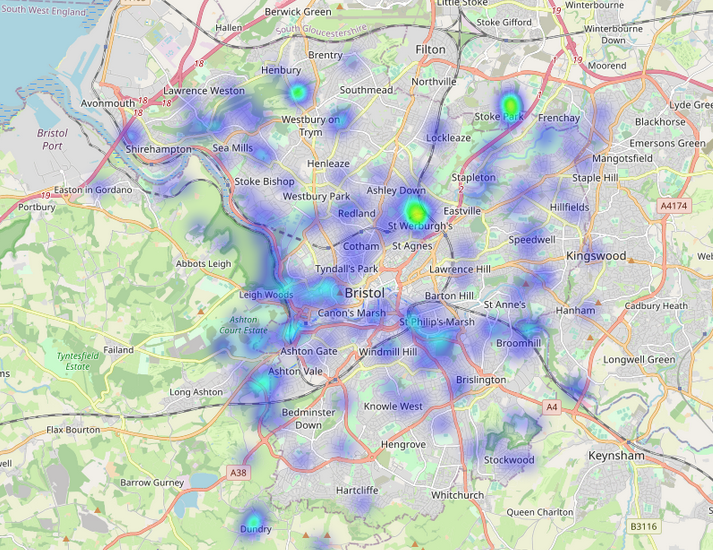

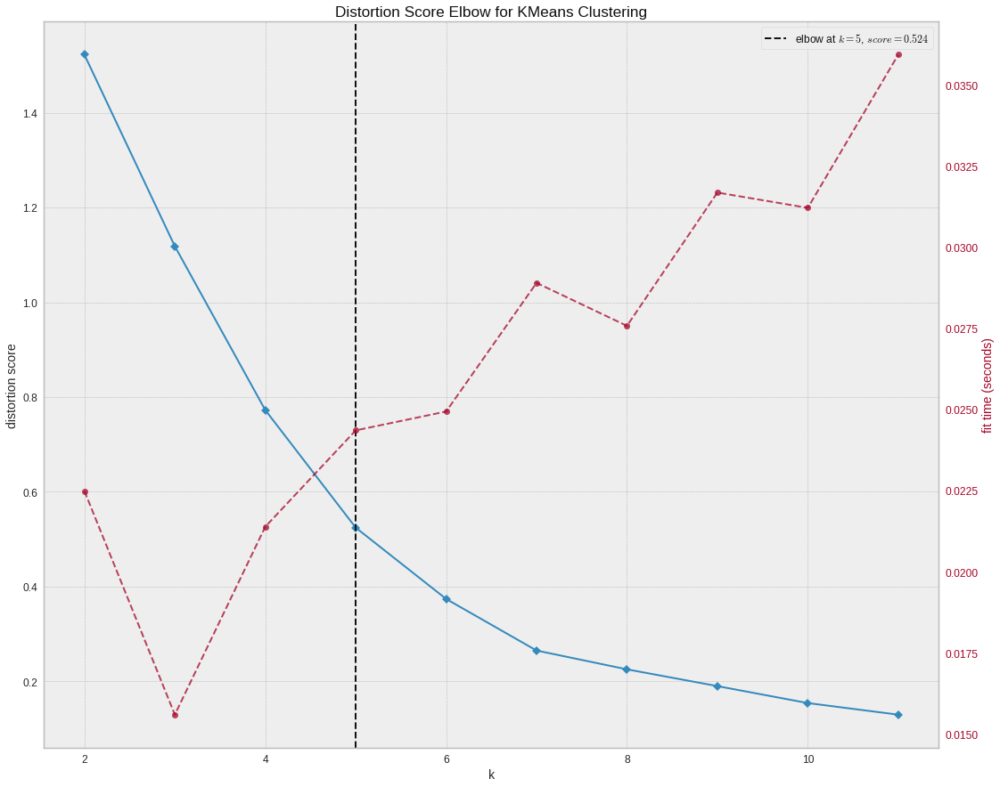

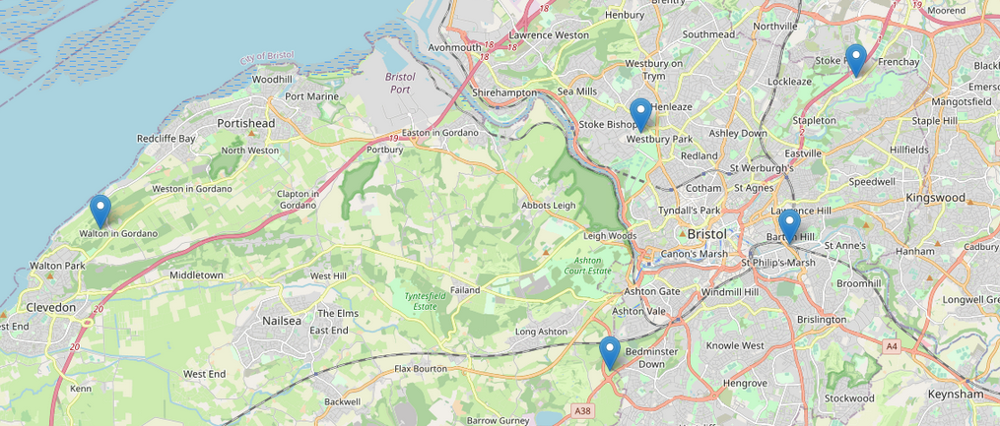

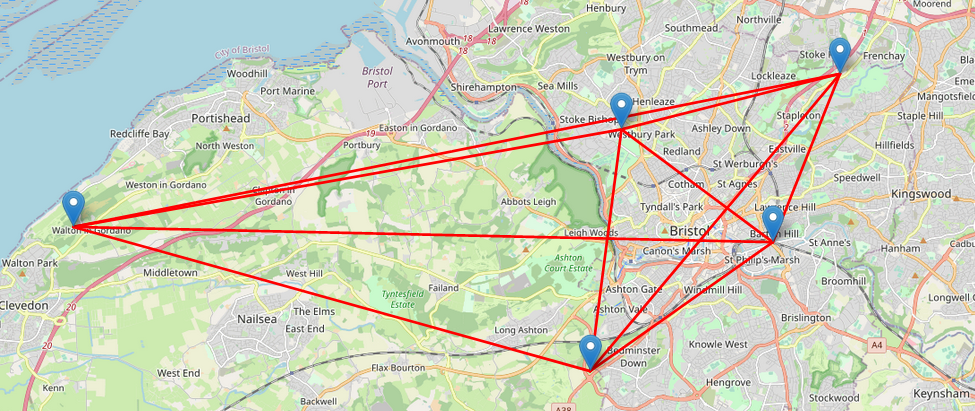

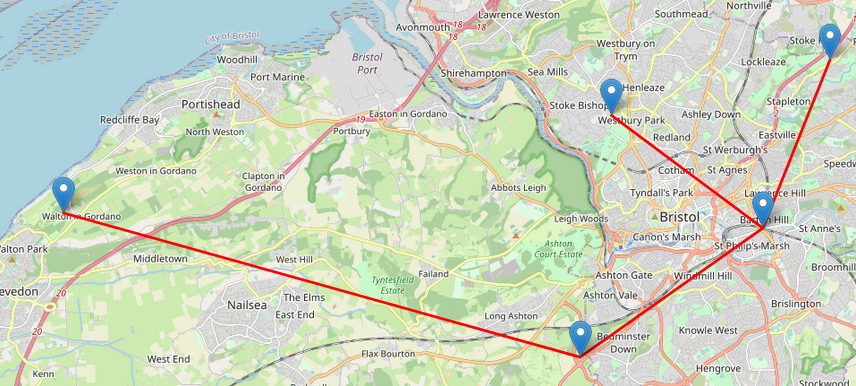

...

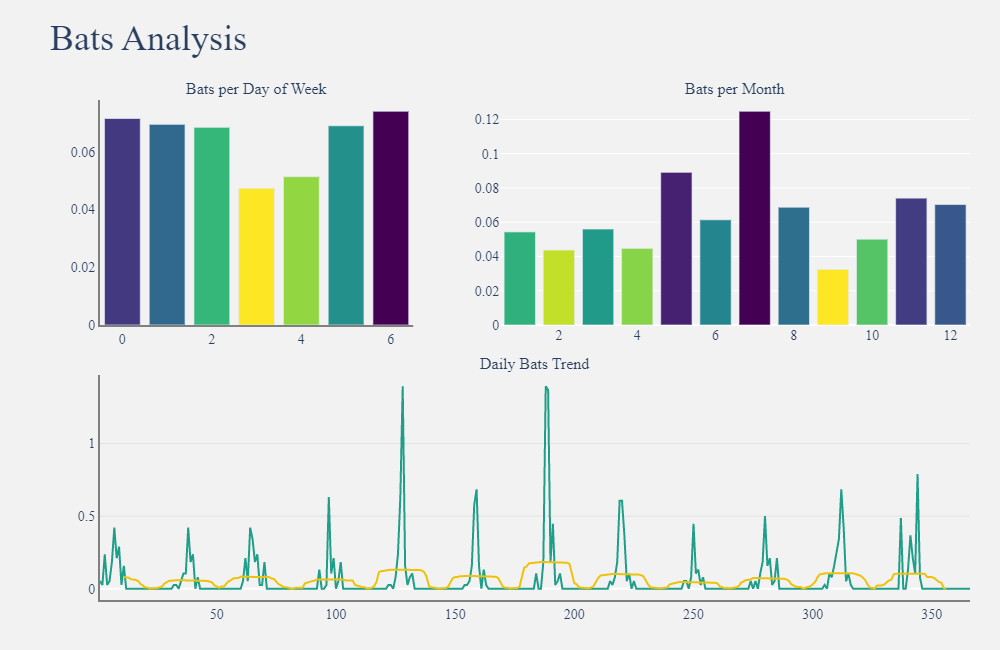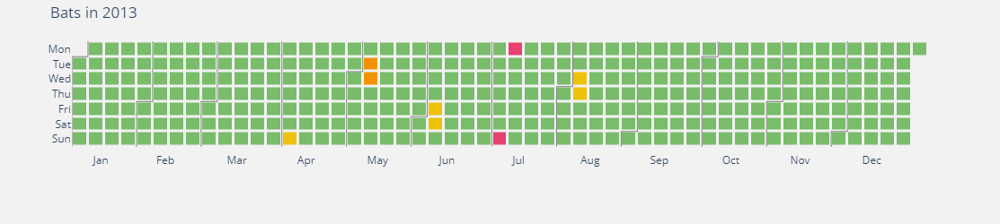

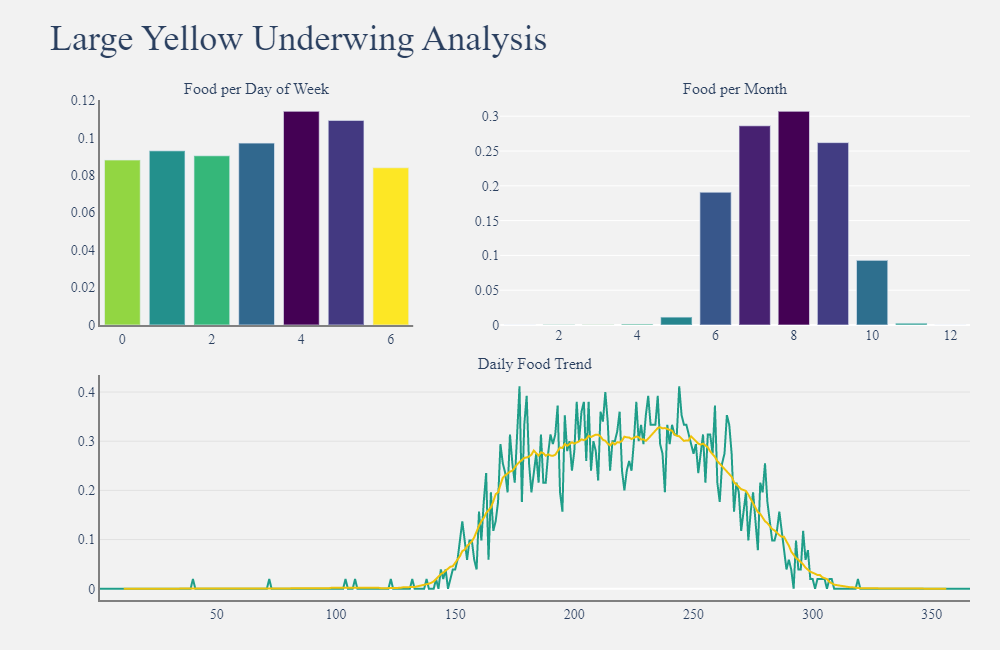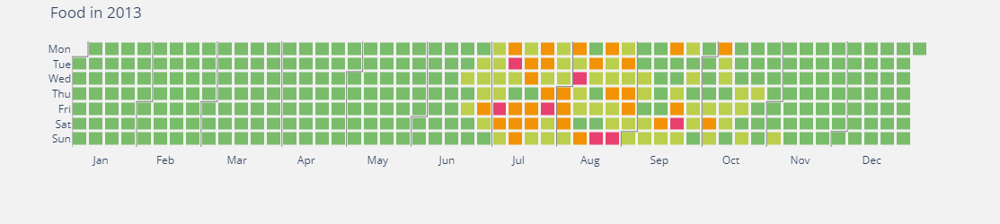

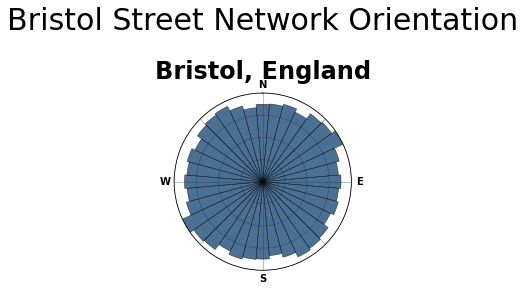

## 👓 References 
List all of the external links (even if they are already linked above), such as external datasets, papers, blog posts, code repositories and any other materials. 
 
Dataset 
* https://wdl-data.fra1.digitaloceanspaces.com/bristol/2022_05_30_bristol_datasets.zip
* https://opendata.bristol.gov.uk/

Paper 
* https://www.ecologyandsociety.org/vol26/iss1/art15/ES-2020-12156.pdf
* https://rdcu.be/cDGyW
* https://www.batcon.org/article/hiding-from-the-lights/
* https://pubmed.ncbi.nlm.nih.gov/34265558/
* https://www.bathnes.gov.uk/sites/default/files/ba306_bath_bats_and_lighting_guide_10_june_2018.pdf
 
Resource 
* https://osmnx.readthedocs.io/en/stable/
* https://dash.plotly.com/

## ⏭️ Appendix


Some of the tests we performed are just placed here.

##### Bats

**General information**

In [ ]:
print(f'Number of rows: {bats.shape[0]};  Number of columns: {bats.shape[1]}; Number of missing values: {sum(bats.isna().sum())}')

Number of rows: 896;  Number of columns: 4; Number of missing values: 0


In [ ]:
unique_times = bats.index.unique()
print(f'Number of unique times: {unique_times.shape[0]}')
print(f'Earliest date: {unique_times.min()}')
print(f'Latest date: {unique_times.max()}')

Number of unique times: 348
Earliest date: 1982-11-10 00:00:00
Latest date: 2020-12-02 00:00:00


**Pivoting Table**

This gives us an overview of the number of bats per day

In [ ]:
pivotbats = bats.pivot_table('UNIQUE_NO', aggfunc=np.size, columns='COMMON_NAM', index=bats.index, fill_value=0)
idx = pd.date_range('1982-11-10', '2020-12-02')
pivotbats.index = pd.DatetimeIndex(pivotbats.index)
pivotbats = pivotbats.reindex(idx, fill_value=0)
pivotbats

COMMON_NAM,Barbastelle,Brown Long-eared Bat,Common Pipistrelle,Daubenton's Bat,Greater Horseshoe Bat,Leisler's Bat,Lesser Horseshoe Bat,Nathusius' Pipistrelle,Natterer's Bat,Noctule,...,Soprano Pipistrelle (55kHz),Whiskered Bat,Whiskered/Brandt's Bat,a Brown Long-eared or Grey Long-eared or other Plecotus bat (unidentified),a Myotis bat (unidentified),a Nyctalus or a Eptesicus bat species (unidentified),a Nyctalus species (unidentified),a Pipistrelle (unidentified),a Vespertilionidae Bat (unidentified),a bat (unidentified)
1982-11-10,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1982-11-11,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1982-11-12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1982-11-13,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1982-11-14,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-11-28,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2020-11-29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2020-11-30,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2020-12-01,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


**Overview plots**

<AxesSubplot:>

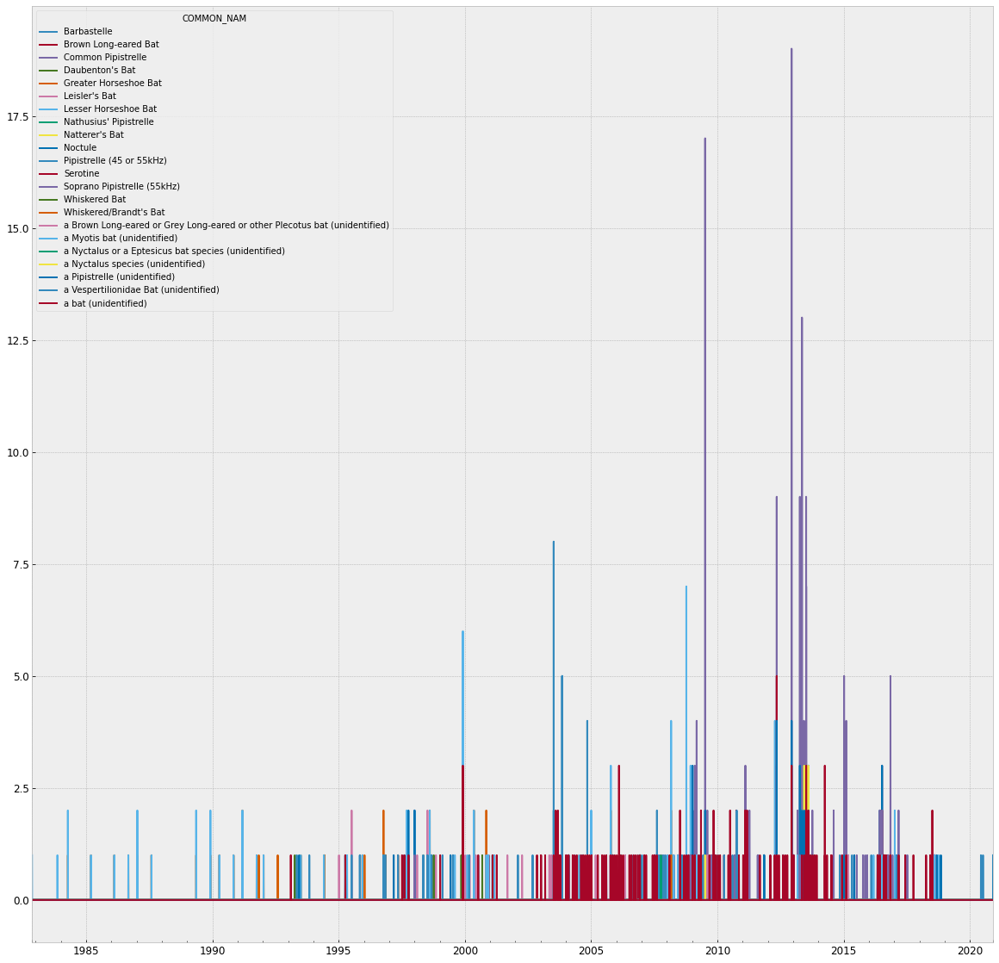

In [ ]:
pivotbats.plot()

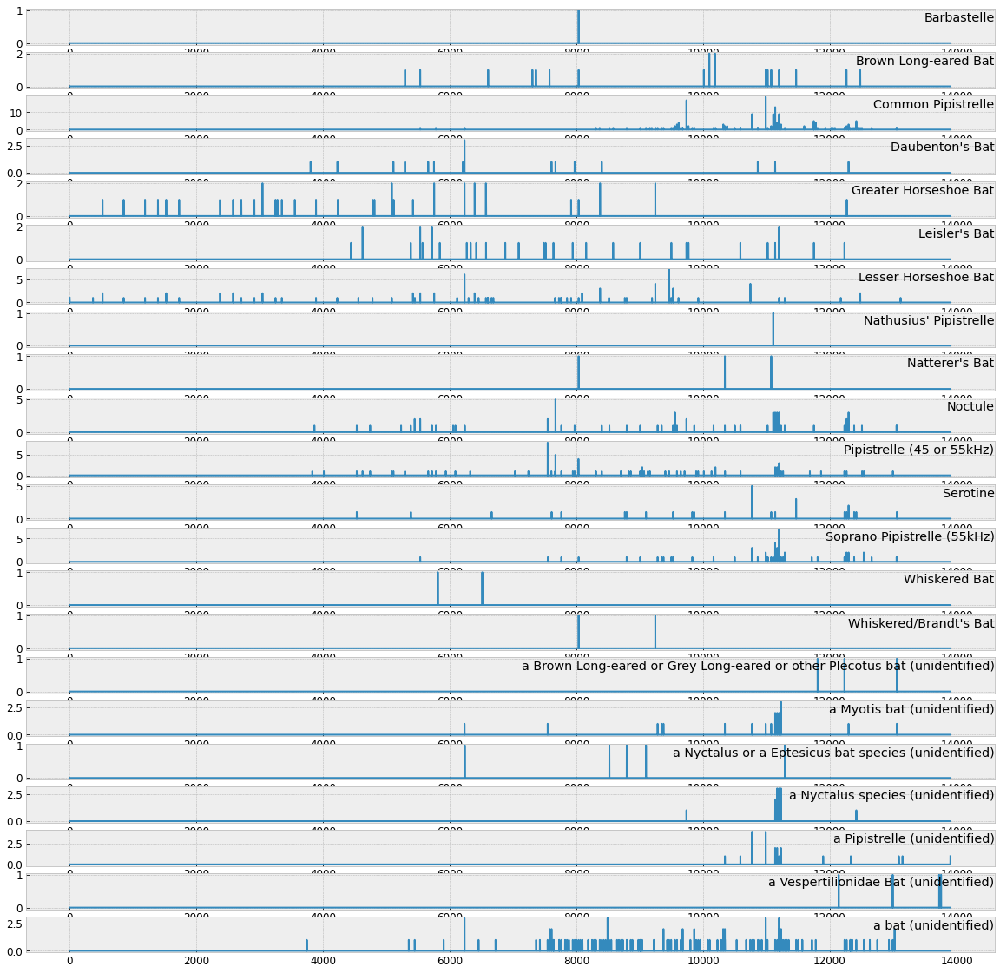

In [ ]:
rcParams['figure.figsize'] = 20, 20
values = pivotbats.values
groups = list(range(len(pivotbats.columns)))
i = 1
# plot each column
for group in groups:
    plt.subplot(len(groups), 1, i)
    plt.plot(values[:, group])
    plt.title(pivotbats.columns[group], y=0.5, loc='right')
    i += 1
plt.show()

Here we just plot the bats sightings to see how the timeline evolves. We immediately notice some anomalies, as the timeseries seems have lots of missing points. These is due to when the sightings are recorded, a lot of days do not have recordings.

**Total and average bats**

We add two new columns that indicate de total bats per day and the average bats.

In [ ]:
pivotbats['Total'] = pivotbats.sum(numeric_only=True, axis=1)
pivotbats['Average'] = pivotbats.mean(numeric_only=True, axis=1)

**Days with most bats**

In [ ]:
pivotbats.nlargest(10, 'Total')['Total']

2012-12-09    30
2013-07-08    29
2013-07-07    24
2012-05-07    23
2013-05-08    23
2009-07-07    21
2013-05-07    21
1999-12-03    15
2013-06-08    15
2013-04-07    14
Name: Total, dtype: int64

**Analysing the bats**

In [ ]:
very_low = "#79bc6a"
low = "#bbcf4c"
medium = "#eec20b"
high = "#f29305"
very_high = "#e8416f"
colors = [very_low, low, medium, high, very_high]


def discrete_colorscale(bvals, colors):
    """
    bvals - list of values bounding intervals/ranges of interest
    colors - list of rgb or hex colorcodes for values in [bvals[k], bvals[k+1]],0<=k < len(bvals)-1
    returns the plotly  discrete colorscale
    """
    if len(bvals) != len(colors)+1:
        raise ValueError('len(boundary values) should be equal to  len(colors)+1')
    bvals = sorted(bvals)     
    nvals = [(v-bvals[0])/(bvals[-1]-bvals[0]) for v in bvals]  #normalized values
    
    dcolorscale = [] #discrete colorscale
    for k in range(len(colors)):
        dcolorscale.extend([[nvals[k], colors[k]], [nvals[k+1], colors[k]]])
    return dcolorscale    

def display_year(z,
                 year: int = None,
                 month_lines: bool = True,
                 fig=None,
                 row: int = None):
    
    if year is None:
        year = datetime.datetime.now().year
    
    data = np.ones(365) * np.nan
    data[:len(z)] = z
    

    d1 = datetime.date(year, 1, 1)
    d2 = datetime.date(year, 12, 31)

    delta = d2 - d1
    
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    month_days =   [31,    28,    31,     30,    31,     30,    31,    31,    30,    31,    30,    31]
    month_positions = (np.cumsum(month_days) - 15)/7

    dates_in_year = [d1 + datetime.timedelta(i) for i in range(delta.days+1)] #gives me a list with datetimes for each day a year
    weekdays_in_year = [i.weekday() for i in dates_in_year] #gives [0,1,2,3,4,5,6,0,1,2,3,4,5,6,…] (ticktext in xaxis dict translates this to weekdays
    
    weeknumber_of_dates = [int(i.strftime("%V")) if not (int(i.strftime("%V")) == 1 and i.month == 12) else 53
                           for i in dates_in_year] #gives [1,1,1,1,1,1,1,2,2,2,2,2,2,2,…] name is self-explanatory
    text = [str(i) for i in dates_in_year] #gives something like list of strings like ‘2018-01-25’ for each date. Used in data trace to make good hovertext.
    #4cc417 green #347c17 dark green
    colorscale=discrete_colorscale([0, 1, 2, 3, 4, 5], colors)
    
    # handle end of year
    

    data = [
        go.Heatmap(
            x=weeknumber_of_dates,
            y=weekdays_in_year,
            z=data,
            text=text,
            hoverinfo='text+z',
            xgap=3, # this
            ygap=3, # and this is used to make the grid-like apperance
            showscale=False,
            colorscale=colorscale
        )
    ]
    
        
    if month_lines:
        kwargs = dict(
            mode='lines',
            line=dict(
                color='gray',
                width=1
            ),
            hoverinfo='skip'
            
        )
        for date, dow, wkn in zip(dates_in_year,
                                  weekdays_in_year,
                                  weeknumber_of_dates):
            if date.day == 1:
                data += [
                    go.Scatter(
                        x=[wkn-.5, wkn-.5],
                        y=[dow-.5, 6.5],
                        **kwargs
                    )
                ]
                if dow:
                    data += [
                    go.Scatter(
                        x=[wkn-.5, wkn+.5],
                        y=[dow-.5, dow - .5],
                        **kwargs
                    ),
                    go.Scatter(
                        x=[wkn+.5, wkn+.5],
                        y=[dow-.5, -.5],
                        **kwargs
                    )
                ]
                    
                    
    layout = go.Layout(
        title='Bats in 2013',
        height=250,
        yaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'],
            tickvals=[0, 1, 2, 3, 4, 5, 6],
            autorange="reversed"
        ),
        xaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=month_names,
            tickvals=month_positions
        ),
        margin = dict(t=40),
        showlegend=False
    )

    if fig is None:
        fig = go.Figure(data=data, layout=layout)
        fig.update_layout(plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
    else:
        fig.add_traces(data, rows=[(row+1)]*len(data), cols=[1]*len(data))
        fig.update_layout(layout, plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
        fig.update_xaxes(layout['xaxis'])
        fig.update_yaxes(layout['yaxis'])
    
    return fig


def display_years(z, years):
    fig = make_subplots(rows=len(years), cols=1, subplot_titles=years)
    for i, year in enumerate(years):
        data = z[i*365 : (i+1)*365]
        display_year(data, year=year, fig=fig, row=i)
        fig.update_layout(height=250*len(years), width=1300)
        
    return fig

In [ ]:
pivotbats = pivotbats.reset_index()
pivotbats.rename(columns = {'index':'Date'}, inplace = True)

In [ ]:
palette = cycle(px.colors.sequential.Viridis)
df_graph = pivotbats[['Date', 'Total']]
df2012 = pivotbats[pivotbats['Date'].dt.year == 2012]
df2013 = pivotbats[pivotbats['Date'].dt.year == 2013]

# chart
fig = make_subplots(rows=2, cols=2, 
                    specs=[[{"type": "bar"}, {"type": "bar"}], [{"colspan": 2}, None]],
                    column_widths=[0.4, 0.6], vertical_spacing=0.1, horizontal_spacing=0.1,
                    subplot_titles=("Bats per Day of Week", "Bats per Month", "Daily Bats Trend"))

# Upper Left chart
df_day = df_graph.groupby([df_graph["Date"].dt.weekday]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(7))
fig.add_trace(go.Bar(x=df_day["Date"], y=df_day['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Day of Week'),
                      row=1, col=1)
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Upper Right chart
df_month = df_graph.groupby([df_graph["Date"].dt.month]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(12))
fig.add_trace(go.Bar(x=df_month["Date"], y=df_month['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Month'),
                      row=1, col=2)
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Medium Chart
df_week = df_graph.groupby([df_graph["Date"].dt.dayofyear]).mean().reset_index()
fig.add_trace(go.Scatter(x = df_week["Date"], y = df_week['Total'], mode='lines',
                        marker = dict(color = px.colors.sequential.Viridis[5]),
                        name='Daily Validations'), row = 2, col = 1)

from statsmodels.tsa.seasonal import seasonal_decompose
decomp = seasonal_decompose(df_week['Total'], model='additive', freq = 21)

fig.add_trace(go.Scatter(x = df_week["Date"], y = decomp.trend, mode='lines',
                       marker = dict(color = medium),
                        name='Trend'), row = 2, col = 1)
    
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, row=2, col=1)
fig.update_yaxes(gridcolor = 'gray', gridwidth = 0.15, linecolor='gray',linewidth=2, row=2, col=1)

# General Styling
fig.update_layout(height=650, width=1000, bargap=0.2,
                  margin=dict(b=50,r=30,l=100),
                  title = "<span style='font-size:36px; font-family:Times New Roman'>Bats Analysis</span>",                  
                  plot_bgcolor='rgb(242,242,242)',
                  paper_bgcolor = 'rgb(242,242,242)',
                  font=dict(family="Times New Roman", size= 14),
                  hoverlabel=dict(font_color="floralwhite"),
                  showlegend=False)
fig.show()

# z = df_graph.groupby([df_graph["Date"].dt.dayofyear])['Total'].max()
z = df2013.groupby([df2013["Date"].dt.dayofyear])['Total'].max()
display_year(z[:-1], 2013)

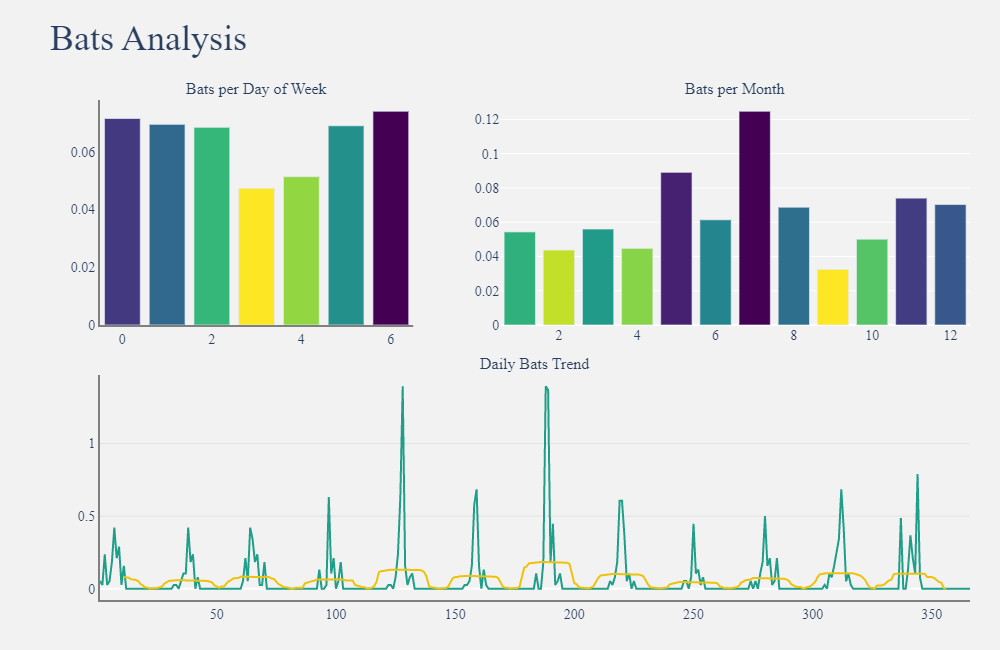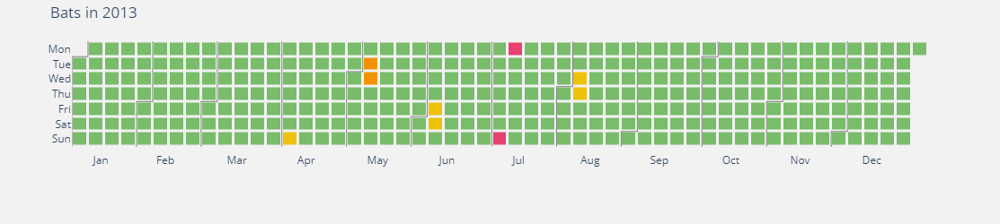

##### Large Yellow Underwing
One of the food sources for bats

**Pivoting Table**

In [ ]:
food['Date'] = pd.to_datetime(food['Date_of_Record'], infer_datetime_format=True, errors='coerce')
food.drop(columns=['Scientific_Name', 'Common_Name', 'Unnamed: 0', 'Record_Type', 'Grid_Ref', 'Abundance', 'Sex_Stage', 'Year_Date', 'Date_of_Record'], inplace=True)
food.set_index('Date', inplace=True)
pivotfood = food.pivot_table('Unique_No', aggfunc=np.size, index=food.index, fill_value=0)

In [ ]:
unique_times = pivotfood.index.unique()
print(f'Number of unique times: {unique_times.shape[0]}')
print(f'Earliest date: {unique_times.min()}')
print(f'Latest date: {unique_times.max()}')

Number of unique times: 1525
Earliest date: 1970-08-16 00:00:00
Latest date: 2021-07-15 00:00:00


In [ ]:
idx = pd.date_range('1970-08-16', '2021-07-15')
pivotfood.index = pd.DatetimeIndex(pivotfood.index)
pivotfood = pivotfood.reindex(idx, fill_value=0)
pivotfood

,Unique_No
1970-08-16,1
1970-08-17,0
1970-08-18,0
1970-08-19,0
1970-08-20,0
...,...
2021-07-11,0
2021-07-12,0
2021-07-13,0
2021-07-14,0


**Overview**

<AxesSubplot:>

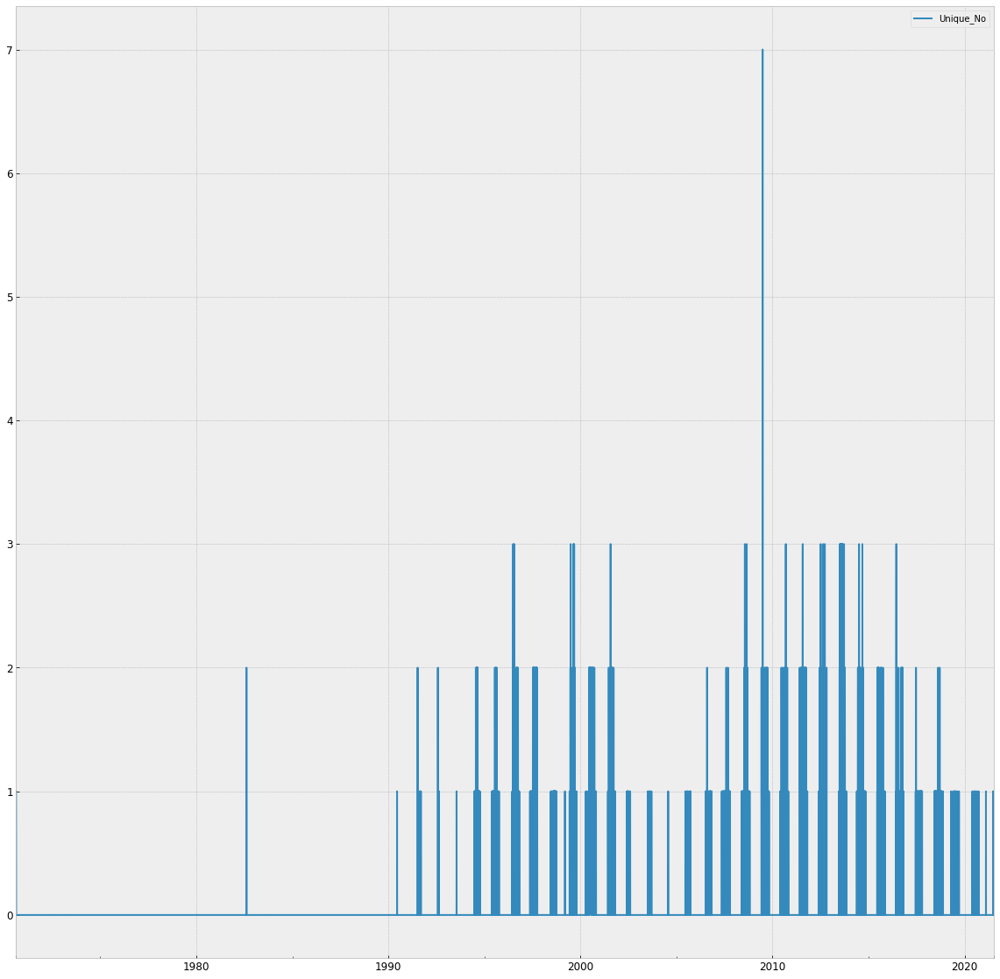

In [ ]:
pivotfood.plot()

**Days with most moths**

In [ ]:
pivotfood.nlargest(10, 'Unique_No')

,Unique_No
2009-06-26,7
1996-07-01,3
1996-07-20,3
1999-06-29,3
1999-08-20,3
1999-09-04,3
2001-07-28,3
2008-07-24,3
2008-08-28,3
2010-09-10,3


In [ ]:
very_low = "#79bc6a"
low = "#bbcf4c"
medium = "#eec20b"
high = "#f29305"
very_high = "#e8416f"
colors = [very_low, low, medium, high, very_high]


def discrete_colorscale(bvals, colors):
    """
    bvals - list of values bounding intervals/ranges of interest
    colors - list of rgb or hex colorcodes for values in [bvals[k], bvals[k+1]],0<=k < len(bvals)-1
    returns the plotly  discrete colorscale
    """
    if len(bvals) != len(colors)+1:
        raise ValueError('len(boundary values) should be equal to  len(colors)+1')
    bvals = sorted(bvals)     
    nvals = [(v-bvals[0])/(bvals[-1]-bvals[0]) for v in bvals]  #normalized values
    
    dcolorscale = [] #discrete colorscale
    for k in range(len(colors)):
        dcolorscale.extend([[nvals[k], colors[k]], [nvals[k+1], colors[k]]])
    return dcolorscale    

def display_year(z,
                 year: int = None,
                 month_lines: bool = True,
                 fig=None,
                 row: int = None):
    
    if year is None:
        year = datetime.datetime.now().year
    
    data = np.ones(365) * np.nan
    data[:len(z)] = z
    

    d1 = datetime.date(year, 1, 1)
    d2 = datetime.date(year, 12, 31)

    delta = d2 - d1
    
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    month_days =   [31,    28,    31,     30,    31,     30,    31,    31,    30,    31,    30,    31]
    month_positions = (np.cumsum(month_days) - 15)/7

    dates_in_year = [d1 + datetime.timedelta(i) for i in range(delta.days+1)] #gives me a list with datetimes for each day a year
    weekdays_in_year = [i.weekday() for i in dates_in_year] #gives [0,1,2,3,4,5,6,0,1,2,3,4,5,6,…] (ticktext in xaxis dict translates this to weekdays
    
    weeknumber_of_dates = [int(i.strftime("%V")) if not (int(i.strftime("%V")) == 1 and i.month == 12) else 53
                           for i in dates_in_year] #gives [1,1,1,1,1,1,1,2,2,2,2,2,2,2,…] name is self-explanatory
    text = [str(i) for i in dates_in_year] #gives something like list of strings like ‘2018-01-25’ for each date. Used in data trace to make good hovertext.
    #4cc417 green #347c17 dark green
    colorscale=discrete_colorscale([0, 1, 2, 3, 4, 5], colors)
    
    # handle end of year
    

    data = [
        go.Heatmap(
            x=weeknumber_of_dates,
            y=weekdays_in_year,
            z=data,
            text=text,
            hoverinfo='text+z',
            xgap=3, # this
            ygap=3, # and this is used to make the grid-like apperance
            showscale=False,
            colorscale=colorscale
        )
    ]
    
        
    if month_lines:
        kwargs = dict(
            mode='lines',
            line=dict(
                color='gray',
                width=1
            ),
            hoverinfo='skip'
            
        )
        for date, dow, wkn in zip(dates_in_year,
                                  weekdays_in_year,
                                  weeknumber_of_dates):
            if date.day == 1:
                data += [
                    go.Scatter(
                        x=[wkn-.5, wkn-.5],
                        y=[dow-.5, 6.5],
                        **kwargs
                    )
                ]
                if dow:
                    data += [
                    go.Scatter(
                        x=[wkn-.5, wkn+.5],
                        y=[dow-.5, dow - .5],
                        **kwargs
                    ),
                    go.Scatter(
                        x=[wkn+.5, wkn+.5],
                        y=[dow-.5, -.5],
                        **kwargs
                    )
                ]
                    
                    
    layout = go.Layout(
        title='Food in 2013',
        height=250,
        yaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'],
            tickvals=[0, 1, 2, 3, 4, 5, 6],
            autorange="reversed"
        ),
        xaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=month_names,
            tickvals=month_positions
        ),
        margin = dict(t=40),
        showlegend=False
    )

    if fig is None:
        fig = go.Figure(data=data, layout=layout)
        fig.update_layout(plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
    else:
        fig.add_traces(data, rows=[(row+1)]*len(data), cols=[1]*len(data))
        fig.update_layout(layout, plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
        fig.update_xaxes(layout['xaxis'])
        fig.update_yaxes(layout['yaxis'])
    
    return fig


def display_years(z, years):
    fig = make_subplots(rows=len(years), cols=1, subplot_titles=years)
    for i, year in enumerate(years):
        data = z[i*365 : (i+1)*365]
        display_year(data, year=year, fig=fig, row=i)
        fig.update_layout(height=250*len(years), width=1300)
        
    return fig

In [ ]:
pivotfood = pivotfood.reset_index()
pivotfood.rename(columns = {'index':'Date', 'Unique_No':'Total'}, inplace = True)

In [ ]:
palette = cycle(px.colors.sequential.Viridis)
df_graph = pivotfood[['Date', 'Total']]
df2012 = pivotfood[pivotfood['Date'].dt.year == 2012]
df2013 = pivotfood[pivotfood['Date'].dt.year == 2013]

# chart
fig = make_subplots(rows=2, cols=2, 
                    specs=[[{"type": "bar"}, {"type": "bar"}], [{"colspan": 2}, None]],
                    column_widths=[0.4, 0.6], vertical_spacing=0.1, horizontal_spacing=0.1,
                    subplot_titles=("Food per Day of Week", "Food per Month", "Daily Food Trend"))

# Upper Left chart
df_day = df_graph.groupby([df_graph["Date"].dt.weekday]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(7))
fig.add_trace(go.Bar(x=df_day["Date"], y=df_day['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Day of Week'),
                      row=1, col=1)
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Upper Right chart
df_month = df_graph.groupby([df_graph["Date"].dt.month]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(12))
fig.add_trace(go.Bar(x=df_month["Date"], y=df_month['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Month'),
                      row=1, col=2)
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Medium Chart
df_week = df_graph.groupby([df_graph["Date"].dt.dayofyear]).mean().reset_index()
fig.add_trace(go.Scatter(x = df_week["Date"], y = df_week['Total'], mode='lines',
                        marker = dict(color = px.colors.sequential.Viridis[5]),
                        name='Daily Validations'), row = 2, col = 1)

from statsmodels.tsa.seasonal import seasonal_decompose
decomp = seasonal_decompose(df_week['Total'], model='additive', freq = 21)

fig.add_trace(go.Scatter(x = df_week["Date"], y = decomp.trend, mode='lines',
                       marker = dict(color = medium),
                        name='Trend'), row = 2, col = 1)
    
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, row=2, col=1)
fig.update_yaxes(gridcolor = 'gray', gridwidth = 0.15, linecolor='gray',linewidth=2, row=2, col=1)

# General Styling
fig.update_layout(height=650, width=1000, bargap=0.2,
                  margin=dict(b=50,r=30,l=100),
                  title = "<span style='font-size:36px; font-family:Times New Roman'>Large Yellow Underwing Analysis</span>",                  
                  plot_bgcolor='rgb(242,242,242)',
                  paper_bgcolor = 'rgb(242,242,242)',
                  font=dict(family="Times New Roman", size= 14),
                  hoverlabel=dict(font_color="floralwhite"),
                  showlegend=False)
fig.show()

# z = df_graph.groupby([df_graph["Date"].dt.dayofyear])['Total'].max()
z = df2013.groupby([df2013["Date"].dt.dayofyear])['Total'].max()
display_year(z[:-1], 2013)

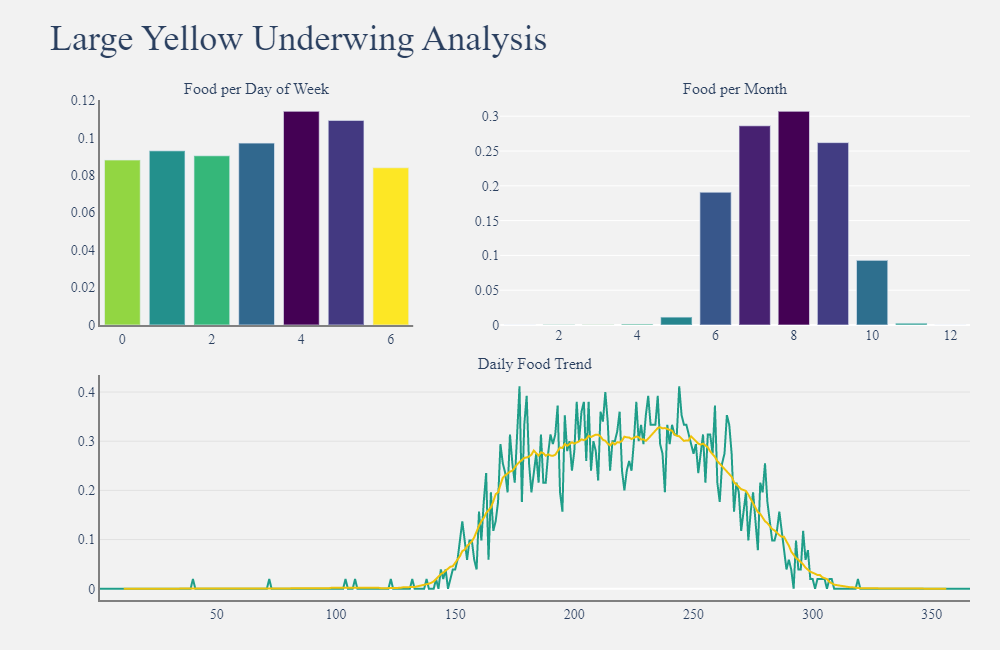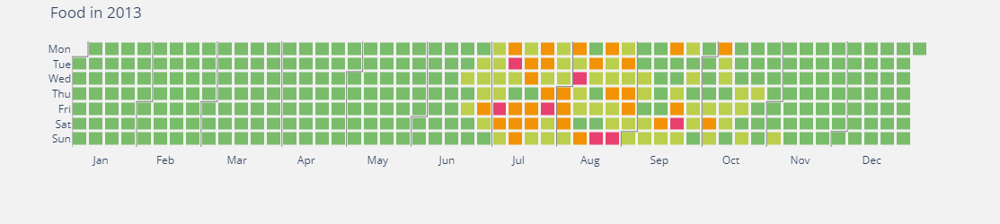

#### **Code to obtain the graphs from OSM**

OSMnx is a Python package that lets you download geospatial data from OpenStreetMap and model, project, visualize, and analyze real-world street networks and any other geospatial geometries. We can use this tool to add any geopatial data to our model

This code is to obtain all the waterways of a place. Specify the place like you would do in google maps, and it will download the osmnx graph with the waterways (rivers). In the next cell, we transform this osmnx graph to an igraph so we can use it in our model.

In [ ]:
# create networkx graph
place = "Bristol, England"
G_nx = ox.graph_from_place(place, retain_all=False, truncate_by_edge=False,
                        simplify=True, custom_filter='["waterway"]')
osmids = list(G_nx.nodes)
G_nx = nx.relabel.convert_node_labels_to_integers(G_nx)

# give each node its original osmid as attribute since we relabeled them
osmid_values = {k: v for k, v in zip(G_nx.nodes, osmids)}
nx.set_node_attributes(G_nx, osmid_values, "osmid")

In [ ]:
%%time
# convert networkx graph to igraph
G_ig = ig.Graph(directed=True)
G_ig.add_vertices(G_nx.nodes)
G_ig.add_edges(G_nx.edges())
G_ig.vs["osmid"] = osmids
G_ig.es[weight] = list(nx.get_edge_attributes(G_nx, weight).values())

#### **Analysing the Street Network**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
import geopandas as gpd
import networkx as nx
from descartes import PolygonPatch
from shapely.geometry import LineString
from shapely.geometry import Point
from shapely.geometry import Polygon

weight_by_length = False

ox.__version__

'1.1.2'

In [ ]:
place = "Bristol, England"

2022-06-14 19:45:18 Bristol, England


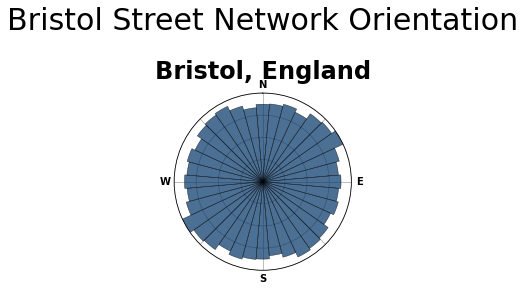

In [ ]:
fig, axes = plt.subplots(1, 1, subplot_kw={"projection": "polar"})

# plot each city's polar histogram
print(ox.utils.ts(), place)

# get undirected graphs with edge bearing attributes
G = ox.graph_from_place(place, network_type="walk")
Gu = ox.add_edge_bearings(ox.get_undirected(G))
fig, ax = ox.bearing.plot_orientation(Gu, ax=axes, title=place, area=True)

# add figure title and save image
suptitle_font = {
    "family": "DejaVu Sans",
    "fontsize": 30,
    "fontweight": "normal",
    "y": 1,
}
fig.suptitle("Bristol Street Network Orientation", **suptitle_font)
fig.tight_layout()
fig.subplots_adjust(hspace=0.35)
plt.show()

#### Point Pattern Analysis

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


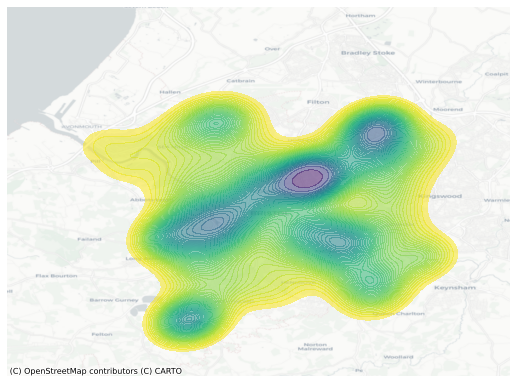

In [ ]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Generate and add KDE with a shading of 50 gradients 
# coloured contours, 75% of transparency,
# and the reverse viridis colormap
seaborn.kdeplot(
    bats['LON'], 
    bats['LAT'],
    n_levels=50, 
    shade=True,
    alpha=0.55, 
    cmap='viridis_r'
)
# Add basemap
contextily.add_basemap(
    ax,
    crs="EPSG:4326",
    source=contextily.providers.CartoDB.Positron
)
# Remove axes
ax.set_axis_off()

In [ ]:
from pointpats import centrography
mean_center = centrography.mean_center(bats[['LON', 'LAT']])
med_center = centrography.euclidean_median(bats[['LON', 'LAT']])

In [ ]:
centrography.std_distance(bats[['LON','LAT']])

0.05200496541640349

In [ ]:
major, minor, rotation = centrography.ellipse(bats[['LON','LAT']])

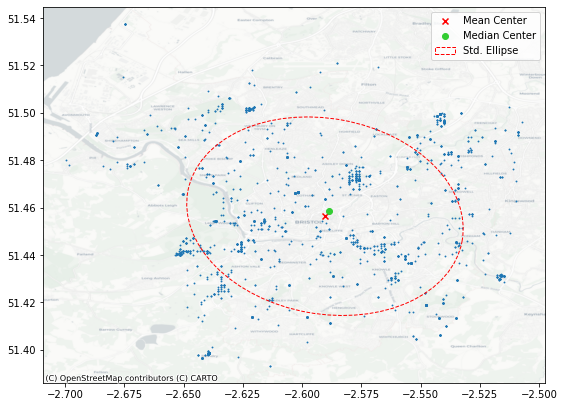

In [ ]:
from matplotlib.patches import Ellipse

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot photograph points
ax.scatter(bats['LON'], bats['LAT'], s=0.75)
ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
ax.scatter(*med_center, color='limegreen', marker='o', label='Median Center')

# Construct the standard ellipse using matplotlib
ellipse = Ellipse(xy=mean_center, # center the ellipse on our mean center
                  width=major*2, # centrography.ellipse only gives half the axis
                  height=minor*2, 
                  angle = numpy.rad2deg(rotation), # Angles for this are in degrees, not radians
                  facecolor='none', 
                  edgecolor='red', linestyle='--',
                  label='Std. Ellipse')
ax.add_patch(ellipse)

ax.legend()
# Display
# Add basemap
contextily.add_basemap(
    ax,
    crs="EPSG:4326", 
    source=contextily.providers.CartoDB.Positron
)
plt.show()

In [ ]:
coordinates = bats[['LON','LAT']].values
convex_hull_vertices = centrography.hull(coordinates)

In [ ]:
import libpysal
alpha_shape, alpha, circs = libpysal.cg.alpha_shape_auto(coordinates, return_circles=True)

/usr/local/lib/python3.7/dist-packages/pygeos/io.py:89: UserWarning: The shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the PyGEOS GEOS version (3.10.1-CAPI-1.16.0). Conversions between both will be slow
  geos_version_string, geos_capi_version_string


/usr/local/lib/python3.7/dist-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])


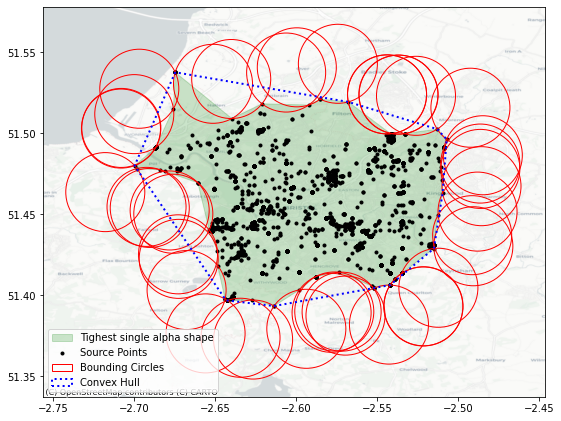

In [ ]:
from descartes import PolygonPatch #to plot the alpha shape easily
f,ax = plt.subplots(1,1, figsize=(9,9))

# Plot a green alpha shape
ax.add_patch(
    PolygonPatch(
        alpha_shape, 
        edgecolor='green', 
        facecolor='green', 
        alpha=.2, 
        label = 'Tighest single alpha shape'
    )
)

# Include the points for our prolific user in black
ax.scatter(
    *coordinates.T, color='k', marker='.', label='Source Points'
)

# plot the circles forming the boundary of the alpha shape
for i, circle in enumerate(circs):
    # only label the first circle of its kind
    if i == 0:
        label = 'Bounding Circles'
    else:
        label = None
    ax.add_patch(
        plt.Circle(
            circle, 
            radius=alpha, 
            facecolor='none', 
            edgecolor='r', 
            label=label
        )
    )

# add a blue convex hull
ax.add_patch(
    plt.Polygon(
        convex_hull_vertices, 
        closed=True, 
        edgecolor='blue', 
        facecolor='none', 
        linestyle=':', 
        linewidth=2,
        label='Convex Hull'
    )
)

# Add basemap
contextily.add_basemap(
    ax,
    crs="EPSG:4326",
    source=contextily.providers.CartoDB.Positron
)

plt.legend();

In [ ]:
min_rect_vertices = centrography.minimum_bounding_rectangle(coordinates)
(center_x, center_y), radius = centrography.minimum_bounding_circle(coordinates)

In [ ]:
from matplotlib.patches import Polygon, Circle, Rectangle
from descartes import PolygonPatch

# Make a purple alpha shape
alpha_shape_patch = PolygonPatch(
    alpha_shape, 
    edgecolor='purple', 
    facecolor='none', 
    linewidth=2,
    label='Alpha Shape'
)

# a blue convex hull
convex_hull_patch = Polygon(
    convex_hull_vertices, 
    closed=True, 
    edgecolor='blue', facecolor='none', 
    linestyle=':', linewidth=2,
    label='Convex Hull'
)

# a green minimum rotated rectangle
"""
# Commented out until functionality is added to pointpats
min_rot_rect_patch = Polygon(
    min_rot_rect, 
    closed=True, 
    edgecolor='green', 
    facecolor='none', 
    linestyle='--', 
    label='Min Rotated Rectangle', 
    linewidth=2
)
"""

# compute the width and height of the 
min_rect_width = min_rect_vertices[2] - min_rect_vertices[0]
min_rect_height = min_rect_vertices[2] - min_rect_vertices[0]

# a goldenrod minimum bounding rectangle
min_rect_patch = Rectangle(
    min_rect_vertices[0:2], 
    width = min_rect_width,
    height = min_rect_height,
    edgecolor='goldenrod', facecolor='none', 
    linestyle='dashed', linewidth=2, 
    label='Min Bounding Rectangle', 
)

# and a red minimum bounding circle
circ_patch = Circle(
    (center_x, center_y), 
    radius=radius,
    edgecolor='red', 
    facecolor='none', 
    linewidth=2,
    label='Min Bounding Circle'
)

/usr/local/lib/python3.7/dist-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])


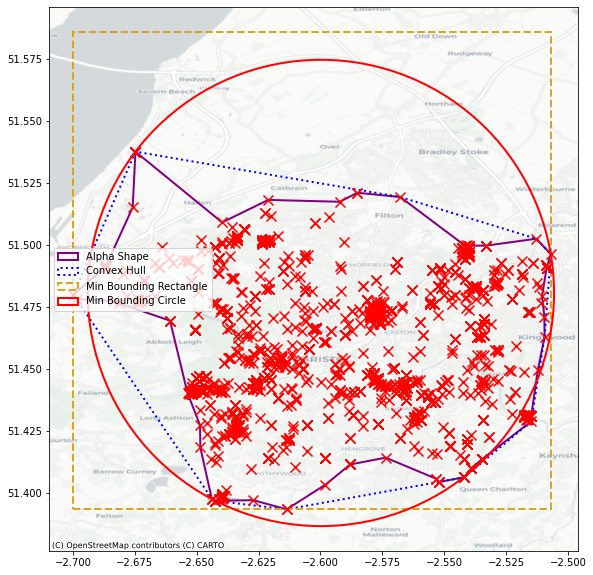

In [ ]:
f,ax = plt.subplots(1, figsize=(10,10))

ax.add_patch(alpha_shape_patch)
ax.add_patch(convex_hull_patch)
# Commented out until functionality is added to pointpats
#ax.add_patch(min_rot_rect_patch)
ax.add_patch(min_rect_patch)
ax.add_patch(circ_patch)

ax.scatter(bats.LON, bats.LAT, s=.75, color='grey')
ax.scatter(bats.LON, bats.LAT, s=100, color='r', marker='x')
ax.legend(ncol=1, loc='center left')

# Add basemap
contextily.add_basemap(
    ax,
    crs="EPSG:4326", 
    source=contextily.providers.CartoDB.Positron
)
plt.show()

In [ ]:
random_pattern_ashape = random.poisson(alpha_shape, size=len(coordinates)//4)

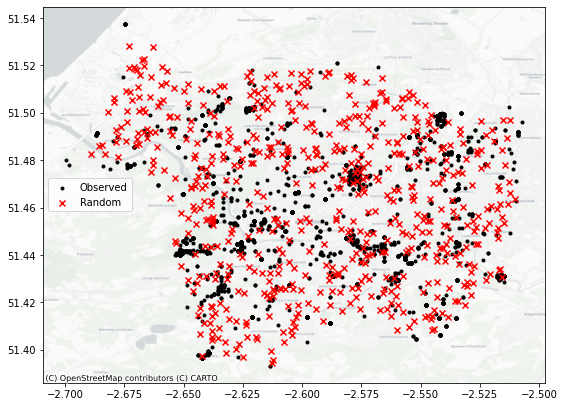

In [ ]:
f,ax = plt.subplots(1, figsize=(9, 9))
plt.scatter(*coordinates.T, color='k', marker='.', label='Observed')
plt.scatter(*random_pattern_ashape.T, color='r', marker='x', label='Random')
contextily.add_basemap(
    ax,
    crs="EPSG:4326", 
    source=contextily.providers.CartoDB.Positron
)
ax.legend(ncol=1, loc='center left')
plt.show()

In [ ]:
g_test = distance_statistics.g_test(
    coordinates, support=40, keep_simulations=True
)

In [ ]:
f_test = distance_statistics.f_test(
    coordinates, support=40, keep_simulations=True
)

In [ ]:
# Define DBSCAN
clusterer = DBSCAN()
# Fit to our data
clusterer.fit(bats[["LON", "LAT"]])

DBSCAN()

In [ ]:
# Print the first 5 elements of `cs`
clusterer.core_sample_indices_[:5]

array([0, 1, 2, 3, 4])

In [ ]:
clusterer.labels_[:5]

array([0, 0, 0, 0, 0])

In [ ]:
lbls = pandas.Series(clusterer.labels_, index=bats.index)

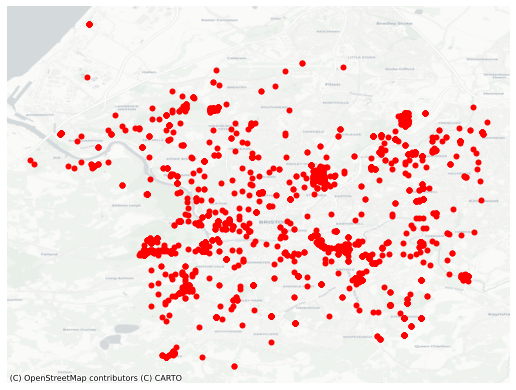

In [ ]:
# Setup figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Subset points that are not part of any cluster (noise)
noise = bats.loc[lbls==-1, ['LON', 'LAT']]
# Plot noise in grey
ax.scatter(noise['LON'], noise['LAT'], c='grey', s=5, linewidth=0)
# Plot all points that are not noise in red
# NOTE how this is done through some fancy indexing, where
#      we take the index of all points (tw) and substract from
#      it the index of those that are noise
ax.scatter(bats.loc[bats.index.difference(noise.index), 'LON'], \
           bats.loc[bats.index.difference(noise.index), 'LAT'], \
          c='red', linewidth=0)
# Add basemap
contextily.add_basemap(
    ax,
    crs="EPSG:4326",
    source=contextily.providers.CartoDB.Positron
)
# Remove axes
ax.set_axis_off()
# Display the figure
plt.show()